# <font color="red">Library imports</font>

In [1]:
import pandas as pd

import numpy as np

import seaborn as sns

import matplotlib.pyplot as plt

import pickle

import warnings

import random

from functools import reduce

from sklearn.preprocessing         import RobustScaler
from sklearn.linear_model          import LinearRegression, Lasso, ElasticNet
from sklearn.svm                   import SVR
from sklearn.ensemble              import RandomForestRegressor
from sklearn.feature_selection     import RFE
from sklearn.model_selection       import LeaveOneOut, RepeatedKFold, cross_val_predict, GridSearchCV
from sklearn.metrics               import explained_variance_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
from sklearn.multioutput           import MultiOutputRegressor

import xgboost as xgb


import scipy.stats as stats

In [2]:
def jupyter_settings():
    
    pd.options.display.max_columns = None   
    


warnings.filterwarnings("ignore")
jupyter_settings()

# <font color="green">Data import and check - ESI (+)</font>

In [3]:
# Data import and checking

df = pd.read_csv('Metabolomics_POS.csv', encoding='latin-1')

df.head()

Primary ID  t0      t1    t1.5      t2    t2.5      t3  \
0   FMTB_ROS_POS_EST1_1_PRÉ 1   0   3.963  10.649  15.275  21.334  21.838   
1  FMTB_ROS_POS_EST1_10_PRÉ 1   0  16.350  20.172  24.839  28.861  29.402   
2  FMTB_ROS_POS_EST1_11_PRÉ 1   0   4.488   6.477   7.581   9.058   9.858   
3  FMTB_ROS_POS_EST1_12_PRÉ 1   0   6.934   7.796   9.980  10.115   9.045   
4  FMTB_ROS_POS_EST1_13_PRÉ 1   0  11.647  11.897  11.228  12.916  12.768   

   t3.333  t3.667      t4  t4.333  t4.667      t5    t5.5      t6      t8  \
0  23.760  22.721  23.052  28.178  25.489  20.783  18.079  16.833  12.338   
1  33.573  32.952  29.256  31.950  27.283  20.534  16.280  14.954   8.936   
2  10.864  10.565  11.140  16.210  14.443  12.929  11.704   9.096   5.791   
3  10.646  10.074   9.560  11.089   9.293   7.527   6.693   5.200   3.173   
4  12.868  11.601  12.802  12.762  13.330  11.210   8.624   8.395   4.142   

     t10    t12    t24    t48    t72    Cmax  AUClast  0.33_161.1057n  \
0  7.755  5.378  1.197  0.312  0.000  28.178  218.631        0.510343   
1  6.166  4.018  1.302  0.678  0.311  33.573  250.282        0.481441   
2  3.424  2.110  0.619  0.204  0.000  16.210  109.506        0.496350   
3  1.710  1.400  0.618  0.000  0.000  11.089   76.060        0.512376   
4  2.325  1.579  1.004  0.998  0.540  13.330  145.164        0.462893   

   6.57_477.2863n  7.73_509.3844n  6.85_515.3145m/z  0.31_649.8247n  \
0        0.465645        0.399526          0.302997        0.426815   
1        0.463180        0.381358          0.299991        0.419109   
2        0.496820        0.389309          0.293026        0.407061   
3        0.451143        0.384413          0.281146        0.424297   
4        0.449016        0.408529          0.294207        0.412222   

   7.52_481.3173n  1.76_224.1283m/z  5.63_449.3148n  6.57_337.2738m/z  \
0        0.439292          0.655098        0.273693          0.207950   
1        0.456273          0.694066        0.315057          0.200647   
2        0.425517          0.664733        0.317699          0.221694   
3        0.407304          0.686281        0.313376          0.208011   
4        0.436482          0.659786        0.321649          0.211764   

   6.85_495.3333n  0.31_203.9625n  0.31_395.9039n  0.50_166.0869m/z  \
0         1.82345        0.689012        0.439087          0.307203   
1         1.82522        0.689545        0.441066          0.303175   
2         1.79602        0.660957        0.421251          0.319468   
3         1.74917        0.691216        0.440676          0.294520   
4         1.81183        0.664830        0.424293          0.295532   

   8.10_240.2332m/z  0.31_293.9132n  1.07_195.0880m/z  0.28_213.9107n  \
0          0.161931        0.411489          0.130649        0.625702   
1          0.162950        0.409767          0.318785        0.627731   
2          0.154907        0.396546          0.124029        0.604485   
3          0.151564        0.411173          0.201006        0.621306   
4          0.156046        0.393533          0.178316        0.606174   

   0.31_717.8118n  0.33_113.0592n  7.68_280.2636m/z  0.79_115.0546m/z  \
0        0.447760        0.297828          0.540264          0.187436   
1        0.441020        0.278472          0.493358          0.198579   
2        0.421331        0.278664          0.464005          0.197745   
3        0.445905        0.283078          0.431833          0.179773   
4        0.430144        0.281144          0.477727          0.189604   

   0.42_132.1024m/z  7.62_549.3794n  6.85_496.5649m/z  0.28_215.9439n  \
0          0.228269        0.380315          0.531635        0.409184   
1          0.244842        0.352622          0.534497        0.422127   
2          0.222991        0.394282          0.524551        0.406837   
3          0.220072        0.368338          0.500370        0.414210   
4          0.229966        0.402235          0.527503        0.405742   

   0.31_565.8637n  6.85_496.4548m/z  7.54_52

In [4]:
# Guardar o nome das amostras em uma lista e o nome das variáveis em outra lista

df_copy = df.copy()

df_copy2 = df.copy()

lista_nome_amostras = list(df_copy['Primary ID'])

lista_nome_variaveis_x = list(df_copy2.iloc[:,23:].columns)

lista_nome_variaveis_y = list(df_copy2.columns[2:20])

In [5]:
# Transformar o nome das amostras em índice:

df = df.set_index('Primary ID')

df.head()

t0      t1    t1.5      t2    t2.5      t3  \
Primary ID                                                               
FMTB_ROS_POS_EST1_1_PRÉ 1    0   3.963  10.649  15.275  21.334  21.838   
FMTB_ROS_POS_EST1_10_PRÉ 1   0  16.350  20.172  24.839  28.861  29.402   
FMTB_ROS_POS_EST1_11_PRÉ 1   0   4.488   6.477   7.581   9.058   9.858   
FMTB_ROS_POS_EST1_12_PRÉ 1   0   6.934   7.796   9.980  10.115   9.045   
FMTB_ROS_POS_EST1_13_PRÉ 1   0  11.647  11.897  11.228  12.916  12.768   

                            t3.333  t3.667      t4  t4.333  t4.667      t5  \
Primary ID                                                                   
FMTB_ROS_POS_EST1_1_PRÉ 1   23.760  22.721  23.052  28.178  25.489  20.783   
FMTB_ROS_POS_EST1_10_PRÉ 1  33.573  32.952  29.256  31.950  27.283  20.534   
FMTB_ROS_POS_EST1_11_PRÉ 1  10.864  10.565  11.140  16.210  14.443  12.929   
FMTB_ROS_POS_EST1_12_PRÉ 1  10.646  10.074   9.560  11.089   9.293   7.527   
FMTB_ROS_POS_EST1_13_PRÉ 1  12.868  11.601  12.802  12.762  13.330  11.210   

                              t5.5      t6      t8    t10    t12    t24  \
Primary ID                                                                
FMTB_ROS_POS_EST1_1_PRÉ 1   18.079  16.833  12.338  7.755  5.378  1.197   
FMTB_ROS_POS_EST1_10_PRÉ 1  16.280  14.954   8.936  6.166  4.018  1.302   
FMTB_ROS_POS_EST1_11_PRÉ 1  11.704   9.096   5.791  3.424  2.110  0.619   
FMTB_ROS_POS_EST1_12_PRÉ 1   6.693   5.200   3.173  1.710  1.400  0.618   
FMTB_ROS_POS_EST1_13_PRÉ 1   8.624   8.395   4.142  2.325  1.579  1.004   

                              t48    t72    Cmax  AUClast  0.33_161.1057n  \
Primary ID                                                                  
FMTB_ROS_POS_EST1_1_PRÉ 1   0.312  0.000  28.178  218.631        0.510343   
FMTB_ROS_POS_EST1_10_PRÉ 1  0.678  0.311  33.573  250.282        0.481441   
FMTB_ROS_POS_EST1_11_PRÉ 1  0.204  0.000  16.210  109.506        0.496350   
FMTB_ROS_POS_EST1_12_PRÉ 1  0.000  0.000  11.089   76.060        0.512376   
FMTB_ROS_POS_EST1_13_PRÉ 1  0.998  0.540  13.330  145.164        0.462893   

                            6.57_477.2863n  7.73_509.3844n  6.85_515.3145m/z  \
Primary ID                                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1         0.465645        0.399526          0.302997   
FMTB_ROS_POS_EST1_10_PRÉ 1        0.463180        0.381358          0.299991   
FMTB_ROS_POS_EST1_11_PRÉ 1        0.496820        0.389309          0.293026   
FMTB_ROS_POS_EST1_12_PRÉ 1        0.451143        0.384413          0.281146   
FMTB_ROS_POS_EST1_13_PRÉ 1        0.449016        0.408529          0.294207   

                            0.31_649.8247n  7.52_481.3173n  1.76_224.1283m/z  \
Primary ID                                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1         0.426815        0.439292          0.655098   
FMTB_ROS_POS_EST1_10_PRÉ 1        0.419109        0.456273          0.694066   
FMTB_ROS_POS_EST1_11_PRÉ 1        0.407061        0.425517          0.664733   
FMTB_ROS_POS_EST1_12_PRÉ 1        0.424297        0.407304          0.686281   
FMTB_ROS_POS_EST1_13_PRÉ 1        0.412222        0.436482          0.659786   

                            5.63_449.3148n  6.57_337.2738m/z  6.85_495.3333n  \
Primary ID                                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1         0.273693          0.207950         1.82345   
FMTB_ROS_POS_EST1_10_PRÉ 1        0.315057          0.200647         1.82522   
FMTB_ROS_POS_EST1_11_PRÉ 1        0.317699          0.221694         1.79602   
FMTB_ROS_POS_EST1_12_PRÉ 1        0.313376          0.208011         1.74917   
FMTB_ROS_POS_EST1_13_PRÉ 1        0.321649          0.211764         1.81183   

                            0.31_203.9625n  0.31_395.9039n  0.50_166.0869m/z  \
Primary ID                                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1         0.689012        0.4

In [6]:
df.shape

(40, 2631)

In [7]:
# Tipo das variáveis

df.dtypes

t0                     int64
t1                   float64
t1.5                 float64
t2                   float64
t2.5                 float64
                      ...   
3.98_498.1940m/z     float64
1.63_638.0975m/z     float64
4.79_1038.8019m/z    float64
4.86_66.0550m/z      float64
0.40_248.1486m/z     float64
Length: 2631, dtype: object

In [8]:
# Verificar dados faltantes

df.isna().sum()

t0                   0
t1                   0
t1.5                 0
t2                   0
t2.5                 0
                    ..
3.98_498.1940m/z     0
1.63_638.0975m/z     0
4.79_1038.8019m/z    0
4.86_66.0550m/z      0
0.40_248.1486m/z     0
Length: 2631, dtype: int64

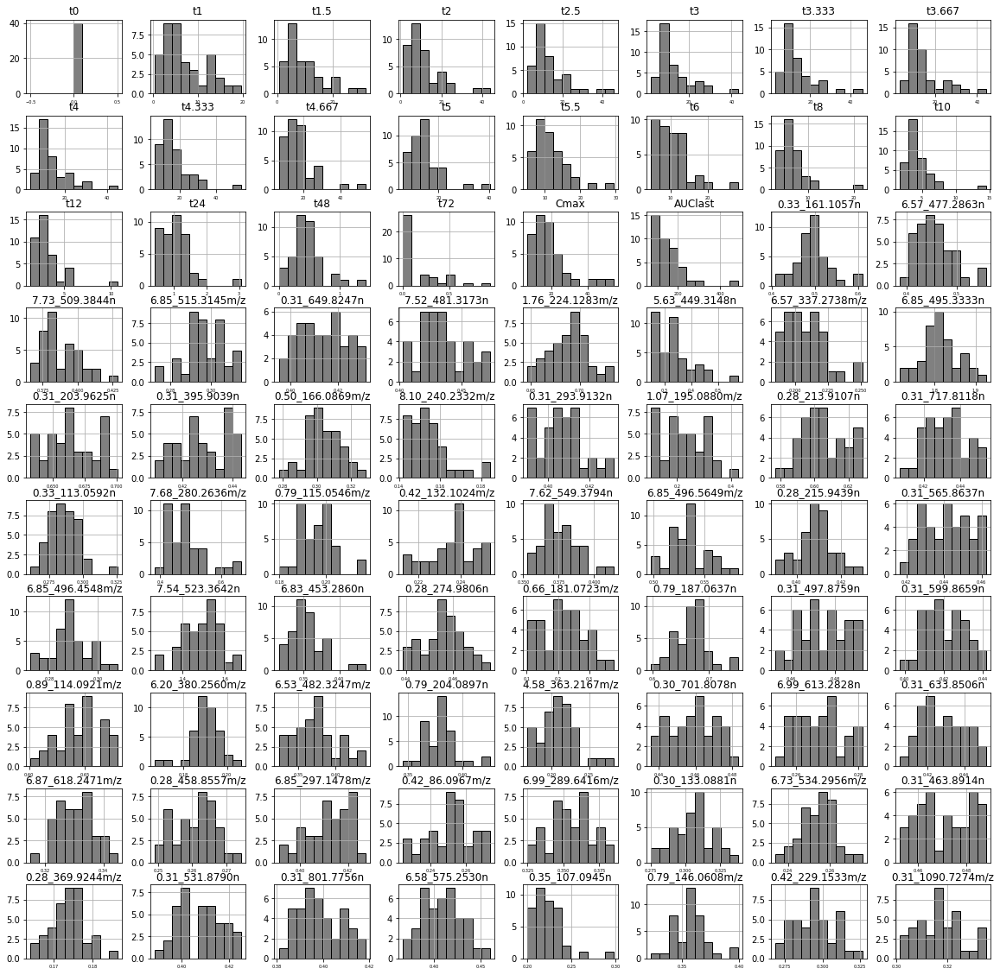

In [8]:
# Verificar distribuição dos features

df.iloc[:,0:80].hist(figsize=(20,20), xlabelsize=5, layout=(10,8), color='grey', edgecolor='black')

plt.show()

# Data preparation

In [9]:
# Data preparation for Machine Learning model(X and Y):


## features

x_train = df.drop(['t0', 't1', 't1.5', 't2', 't2.5', 't3', 't3.333', 't3.667', 't4',
                   't4.333', 't4.667', 't5', 't5.5', 't6', 't8', 't10', 't12', 't24',
                   't48', 't72', 'Cmax', 'AUClast'], axis=1)

## response variable

y_train = df[['t1', 't1.5', 't2', 't2.5', 't3', 't3.333', 't3.667', 't4',
              't4.333', 't4.667', 't5', 't5.5', 't6', 't8', 't10', 't12', 't24',
              't48']].copy()

In [10]:
# Data scaling

transformer = RobustScaler().fit(x_train)

transformer

RobustScaler()

In [11]:
transformer.transform(x_train)

array([[ 0.40307983,  0.35281118,  0.8603892 , ...,  0.52093017,
        -0.74282016,  0.66095676],
       [-0.40613166,  0.29693893, -0.1666172 , ..., -1.58072208,
         1.3139176 , -1.12600257],
       [ 0.01129738,  1.05943085,  0.28283942, ...,  4.42516715,
         1.54312111, -0.33060399],
       ...,
       [ 0.12068736, -0.98556161, -1.01759444, ..., -0.48696376,
         1.20860156,  0.63396163],
       [ 0.2527001 ,  1.06371477,  2.48246916, ..., -0.6218923 ,
        -0.28327285, -0.03648896],
       [-1.12042838, -0.48690459, -0.86027614, ..., -1.5804116 ,
         0.16012375,  0.18609787]])

In [12]:
# Store scaled data in a variable

scaled_x_train = transformer.transform(x_train)

In [13]:
# X data:

scaled_x_train = pd.DataFrame(scaled_x_train)

scaled_x_train.columns = lista_nome_variaveis_x #renome

scaled_x_train['Primary ID'] = lista_nome_amostras # in

scaled_x_train = scaled_x_train.set_index('Primary ID')

In [14]:
scaled_x_train.head()

0.33_161.1057n  6.57_477.2863n  7.73_509.3844n  \
Primary ID                                                                   
FMTB_ROS_POS_EST1_1_PRÉ 1         0.403080        0.352811        0.860389   
FMTB_ROS_POS_EST1_10_PRÉ 1       -0.406132        0.296939       -0.166617   
FMTB_ROS_POS_EST1_11_PRÉ 1        0.011297        1.059431        0.282839   
FMTB_ROS_POS_EST1_12_PRÉ 1        0.460001        0.024106        0.006077   
FMTB_ROS_POS_EST1_13_PRÉ 1       -0.925447       -0.024106        1.369314   

                            6.85_515.3145m/z  0.31_649.8247n  7.52_481.3173n  \
Primary ID                                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1           0.611501        0.962604        0.301888   
FMTB_ROS_POS_EST1_10_PRÉ 1          0.355327        0.425975        0.967477   
FMTB_ROS_POS_EST1_11_PRÉ 1         -0.238234       -0.413022       -0.238038   
FMTB_ROS_POS_EST1_12_PRÉ 1         -1.250655        0.787256       -0.951916   
FMTB_ROS_POS_EST1_13_PRÉ 1         -0.137589       -0.053621        0.191747   

                            1.76_224.1283m/z  5.63_449.3148n  \
Primary ID                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1          -1.437441       -0.578730   
FMTB_ROS_POS_EST1_10_PRÉ 1          0.149026       -0.039694   
FMTB_ROS_POS_EST1_11_PRÉ 1         -1.045180       -0.005265   
FMTB_ROS_POS_EST1_12_PRÉ 1         -0.167917       -0.061600   
FMTB_ROS_POS_EST1_13_PRÉ 1         -1.246583        0.046210   

                            6.57_337.2738m/z  6.85_495.3333n  0.31_203.9625n  \
Primary ID                                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1           0.125510        0.189407        0.889166   
FMTB_ROS_POS_EST1_10_PRÉ 1         -0.278278        0.231683        0.907262   
FMTB_ROS_POS_EST1_11_PRÉ 1          0.885424       -0.465755       -0.063336   
FMTB_ROS_POS_EST1_12_PRÉ 1          0.128882       -1.584761        0.963995   
FMTB_ROS_POS_EST1_13_PRÉ 1          0.336388       -0.088135        0.068157   

                            0.31_395.9039n  0.50_166.0869m/z  \
Primary ID                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1         0.640140          0.357475   
FMTB_ROS_POS_EST1_10_PRÉ 1        0.751992          0.046379   
FMTB_ROS_POS_EST1_11_PRÉ 1       -0.367942          1.304744   
FMTB_ROS_POS_EST1_12_PRÉ 1        0.729950         -0.622077   
FMTB_ROS_POS_EST1_13_PRÉ 1       -0.196010         -0.543917   

                            8.10_240.2332m/z  0.31_293.9132n  \
Primary ID                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1           1.160987        0.452166   
FMTB_ROS_POS_EST1_10_PRÉ 1          1.285335        0.319203   
FMTB_ROS_POS_EST1_11_PRÉ 1          0.303853       -0.701645   
FMTB_ROS_POS_EST1_12_PRÉ 1         -0.104091        0.427766   
FMTB_ROS_POS_EST1_13_PRÉ 1          0.442845       -0.934291   

                            1.07_195.0880m/z  0.28_213.9107n  0.31_717.8118n  \
Primary ID                                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1          -0.687554        1.102162        0.979977   
FMTB_ROS_POS_EST1_10_PRÉ 1          0.877608        1.204615        0.572258   
FMTB_ROS_POS_EST1_11_PRÉ 1         -0.742628        0.030827       -0.618777   
FMTB_ROS_POS_EST1_12_PRÉ 1         -0.102232        0.880190        0.867764   
FMTB_ROS_POS_EST1_13_PRÉ 1         -0.290997        0.116111       -0.085657   

                            0.33_113.0592n  7.68_280.2636m/z  \
Primary ID                                                     
FMTB_ROS_POS_EST1_1_PRÉ 1         0.837549          0.884724   
FMTB_ROS_POS_EST1_10_PRÉ 1       -0.469891          0.256172   
FMTB_ROS_POS_EST1_11_PRÉ 1       -0.456922         -0.137165   
FMTB_ROS_POS_EST1_12_PRÉ 1       -0.158769         -0.568278   
FMTB_ROS_POS_EST1_13_PRÉ 1       -0.289405          0.046713   

  

In [15]:
y_train.shape

(40, 18)

# Feature selection

## RFE algorithm for feature selection

In [85]:
## Evaluating RFE for different number of features
#
#list_features = []
#list_r2 = []
#
#for i in range(2, len(scaled_x_train.columns)+1):
#    
#    print('Now evaluating feature number: {}'.format(i))
#    
#    # Instantiating RFE object
#    rfe = RFE(estimator=ElasticNet(), n_features_to_select=i)
#    
#    # Fitting RFE object
#    rfe.fit(scaled_x_train, y_train)
#    
#    # CV predictions
#    y_cv_predicted = cross_val_predict(rfe, scaled_x_train[rfe.feature_names_in_[rfe.support_]], y_train, cv=LeaveOneOut())
#    
#    # calculating CV R2
#    r2_value = r2_score(y_train,
#                    y_cv_predicted)
#    # appending r2 value to list
#    list_r2.append(r2_value)
#    
#    # appending feature set
#    list_features.append(list(rfe.feature_names_in_[rfe.support_]))
#    
#    print('Features selected for this evaluation: {}'.format(list(rfe.feature_names_in_[rfe.support_])))
#    print('R2: {}\n'.format(r2_value))
#    
#print('Evaluation status: DONE')   

Now evaluating feature number: 2
Features selected for this evaluation: ['0.38_372.7375m/z', '0.33_301.1765m/z']
R2: 0.09695879566998243

Now evaluating feature number: 3
Features selected for this evaluation: ['0.38_372.7375m/z', '0.33_301.1765m/z', '5.67_340.0240m/z']
R2: 0.15660761030734205

Now evaluating feature number: 4
Features selected for this evaluation: ['0.38_372.7375m/z', '5.78_286.1447m/z', '0.33_301.1765m/z', '5.67_340.0240m/z']
R2: 0.18102180414477617

Now evaluating feature number: 5
Features selected for this evaluation: ['0.38_372.7375m/z', '5.78_286.1447m/z', '0.33_301.1765m/z', '5.40_479.5255m/z', '5.67_340.0240m/z']
R2: 0.24802120327663

Now evaluating feature number: 6
Features selected for this evaluation: ['5.51_354.2568n', '0.38_372.7375m/z', '5.78_286.1447m/z', '0.33_301.1765m/z', '5.40_479.5255m/z', '5.67_340.0240m/z']
R2: 0.2690561963551685

Now evaluating feature number: 7
Features selected for this evaluation: ['5.51_354.2568n', '0.38_372.7375m/z', '9.86

Features selected for this evaluation: ['5.51_354.2568n', '5.86_181.1017m/z', '7.78_278.2231n', '10.32_874.5495m/z', '0.31_831.8329m/z', '0.38_372.7375m/z', '9.86_620.4149m/z', '9.65_390.3364m/z', '9.86_617.9329m/z', '7.54_943.1109m/z', '5.78_286.1447m/z', '9.74_684.4726m/z', '0.33_301.1765m/z', '4.24_302.1062m/z', '0.36_227.8795n', '0.30_1301.7099m/z', '5.40_479.5255m/z', '6.73_348.1098m/z', '5.30_1138.1905m/z', '0.30_1231.7143m/z', '3.64_763.0567m/z', '0.28_126.4887m/z', '3.94_686.1865m/z', '5.67_340.0240m/z', '3.26_916.5829m/z']
R2: 0.33865481115669566

Now evaluating feature number: 26
Features selected for this evaluation: ['5.51_354.2568n', '5.86_181.1017m/z', '7.78_278.2231n', '10.32_874.5495m/z', '0.31_831.8329m/z', '0.38_372.7375m/z', '9.86_620.4149m/z', '9.65_390.3364m/z', '9.86_617.9329m/z', '7.54_943.1109m/z', '5.78_286.1447m/z', '9.74_684.4726m/z', '0.33_301.1765m/z', '4.24_302.1062m/z', '0.36_227.8795n', '0.30_1301.7099m/z', '5.40_479.5255m/z', '6.73_348.1098m/z', '5.30_1

Features selected for this evaluation: ['5.51_354.2568n', '5.86_181.1017m/z', '0.33_160.1336m/z', '7.78_278.2231n', '10.32_874.5495m/z', '0.31_831.8329m/z', '0.38_372.7375m/z', '0.70_328.1390m/z', '0.28_537.3567m/z', '0.28_719.7743m/z', '0.28_346.8724m/z', '9.86_620.4149m/z', '9.65_390.3364m/z', '9.86_617.9329m/z', '7.54_943.1109m/z', '5.78_286.1447m/z', '3.43_354.9793m/z', '9.74_684.4726m/z', '0.33_301.1765m/z', '0.36_260.8282m/z', '4.24_302.1062m/z', '0.36_227.8795n', '0.30_1301.7099m/z', '0.68_298.0960m/z', '5.40_479.5255m/z', '6.73_348.1098m/z', '5.30_1138.1905m/z', '6.71_1098.6300m/z', '4.79_831.2448m/z', '0.30_1231.7143m/z', '3.64_763.0567m/z', '0.28_126.4887m/z', '3.94_686.1865m/z', '5.67_340.0240m/z', '5.19_471.1792m/z', '4.81_838.2404m/z', '3.26_916.5829m/z']
R2: 0.27452478839131755

Now evaluating feature number: 38
Features selected for this evaluation: ['5.51_354.2568n', '5.86_181.1017m/z', '0.33_160.1336m/z', '7.78_278.2231n', '10.32_874.5495m/z', '0.31_831.8329m/z', '0.38

KeyboardInterrupt: 

Best features:

['5.51_354.2568n', '5.86_181.1017m/z', '7.78_278.2231n', '10.32_874.5495m/z', '0.31_831.8329m/z', '0.38_372.7375m/z', '9.86_620.4149m/z', '9.65_390.3364m/z', '9.86_617.9329m/z', '5.78_286.1447m/z', '0.33_301.1765m/z', '0.36_227.8795n', '0.30_1301.7099m/z', '5.40_479.5255m/z', '6.73_348.1098m/z', '5.30_1138.1905m/z', '0.30_1231.7143m/z', '3.64_763.0567m/z', '0.28_126.4887m/z', '3.94_686.1865m/z', '5.67_340.0240m/z', '3.26_916.5829m/z']

Score: 0.3594528946595384

# Machine learning 

## Initial evaluation

In [16]:
# selected features

rfe_features = ['5.51_354.2568n', '5.86_181.1017m/z', '7.78_278.2231n', '10.32_874.5495m/z',
                '0.31_831.8329m/z', '0.38_372.7375m/z', '9.86_620.4149m/z', '9.65_390.3364m/z',
                '9.86_617.9329m/z', '5.78_286.1447m/z', '0.33_301.1765m/z', '0.36_227.8795n',
                '0.30_1301.7099m/z', '5.40_479.5255m/z', '6.73_348.1098m/z', '5.30_1138.1905m/z',
                '0.30_1231.7143m/z', '3.64_763.0567m/z', '0.28_126.4887m/z', '3.94_686.1865m/z',
                '5.67_340.0240m/z', '3.26_916.5829m/z']


# scaled_x_train with selected features

selected_x_train = scaled_x_train[rfe_features]

In [57]:
# Modeling - RFE features

# Evaluating models for RFE-selected features (new_X)

#models_to_evaluate = [LinearRegression(n_jobs=-1),
#                      Lasso(random_state=42),
#                      ElasticNet(random_state=42),
#                      RandomForestRegressor(random_state=42, n_jobs=-1),
#                      PLSRegression(max_iter=1000)]
#
#model_names = ['Linear Regression', 'LASSO', 'ElasticNet', 'Random Forest', 'PLS']

# define evaluation procedure
cv = LeaveOneOut()

# list to store LOOCV y splits
y_true_list = list()
y_predicted_list = list()

# lists to store metrics
r2_list = list()

#list to store y predictions
y_predicted_list



models_to_evaluate = [LinearRegression(n_jobs=-1),
                      Lasso(random_state=42),
                      ElasticNet(random_state=42),
                      RandomForestRegressor(random_state=42, n_jobs=-1),
                      xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100,
                                       eta=0.01, max_depth=10, subsample=0.7, colsample_bytree=0.9),
                      SVR(kernel='linear')]

model_names = ['Linear Regression', 'LASSO', 'ElasticNet', 'Random Forest', 'XGBoost', 'SVR']


df_models = pd.DataFrame(index=model_names, columns=[i for i in range(1, selected_x_train.shape[1]+1)])


for i in range(1, selected_x_train.shape[1]+1):
    
    for it, iterator in zip(model_names, models_to_evaluate):
        
        ## enumerate folds
        for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:i])):
            
            X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
            Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]
            
            
        
            # model instance
            regr = MultiOutputRegressor(iterator)
            regr = regr.fit(pd.DataFrame(X_train).iloc[:,:i], Y_train)
            
            # CV predictions
            y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:i])
            
            y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
            y_true_list.append(list(Y_test[0])) # storing y true
            
            # evaluate model metrics on test set
            r2_value = explained_variance_score(y_true_list[-1],
                                                y_predicted_list[-1])
            
            # store r2
            r2_list.append(r2_value)
            
        # filling df_linear_models
        df_models.loc[it, i] = np.mean(r2_list)
        print(df_models)
            
        r2_list  = []    

    
df_models.style.highlight_max(axis=1)

                         1    2    3    4    5    6    7    8    9    10  ...  \
Linear Regression  0.489507  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
LASSO                   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
ElasticNet              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
Random Forest           NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
XGBoost                 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
SVR                     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   

                    13   14   15   16   17   18   19   20   21   22  
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
XGBoost            NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
SVR         

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1    2    3    4    5    6    7    8    9    10  ...  \
Linear Regression  0.489507  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
LASSO              0.503771  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
ElasticNet         0.518237  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
Random Forest      0.016306  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
XGBoost           -0.438593  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   
SVR                     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...   

                    13   14   15   16   17   18   19   20   21   22  
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
XGBoost            NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
SVR         

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2    3    4    5    6    7    8    9    10  \
Linear Regression  0.489507  0.513262  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              0.503771  0.518049  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.518237  0.534027  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.016306  0.237606  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost           -0.438593  0.146902  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
SVR                 0.60002       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   

                   ...   13   14   15   16   17   18   19   20   21   22  
Linear Regression  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
LASSO              ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
ElasticNet         ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
Random Forest      ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
XGBoost            ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3    4    5    6    7    8    9   \
Linear Regression  0.489507  0.513262  0.574774  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              0.503771  0.518049  0.579343  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.518237  0.534027  0.606321  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.016306  0.237606  0.544181  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost           -0.438593  0.146902  0.495449  NaN  NaN  NaN  NaN  NaN  NaN   
SVR                 0.60002  0.593408       NaN  NaN  NaN  NaN  NaN  NaN  NaN   

                    10  ...   13   14   15   16   17   18   19   20   21   22  
Linear Regression  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
LASSO              NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
ElasticNet         NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
Random Forest      NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  
XGBoost            NaN  ...  NaN

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4    5    6    7    8   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  NaN  NaN  NaN  NaN   
LASSO              0.503771  0.518049  0.579343  0.605792  NaN  NaN  NaN  NaN   
ElasticNet         0.518237  0.534027  0.606321  0.653464  NaN  NaN  NaN  NaN   
Random Forest      0.016306  0.237606  0.544181  0.604859  NaN  NaN  NaN  NaN   
XGBoost           -0.438593  0.146902  0.495449  0.609711  NaN  NaN  NaN  NaN   
SVR                 0.60002  0.593408  0.667249       NaN  NaN  NaN  NaN  NaN   

                    9    10  ...   13   14   15   16   17   18   19   20   21  \
Linear Regression  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5    6    7   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  NaN  NaN   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  NaN  NaN   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  NaN  NaN   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  NaN  NaN   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  NaN  NaN   
SVR                 0.60002  0.593408  0.667249  0.713346       NaN  NaN  NaN   

                    8    9    10  ...   13   14   15   16   17   18   19   20  \
Linear Regression  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968       NaN   

                    7    8    9    10  ...   13   14   15   16   17   18   19  \
Linear Regression  NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7    8    9    10  ...   13   14   15   16   17   18  \
Linear Regression   0.56023  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              0.603353  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.674954  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.519743  NaN  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            0.557357

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8    9    10  ...   13   14   15   16   17  \
Linear Regression   0.56023  0.530373  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN   
LASSO              0.603353  0.581697  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.674954  0.669615  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.519743  0.503979  NaN  NaN  ...  NaN  NaN  NaN  NaN  NaN   
XGBoost            0.557357

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9    10  ...   13   14   15   16  \
Linear Regression   0.56023  0.530373  0.531615  NaN  ...  NaN  NaN  NaN  NaN   
LASSO              0.603353  0.581697  0.601546  NaN  ...  NaN  NaN  NaN  NaN   
ElasticNet         0.674954  0.669615  0.681869  NaN  ...  NaN  NaN  NaN  NaN   
Random Forest      0.519743  0.503979  0.535933  NaN  ...  NaN  NaN  NaN  NaN   
XGBoost            0.557357

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...   13   14   15  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  NaN  NaN  NaN   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  NaN  NaN  NaN   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  NaN  NaN  NaN   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  NaN  NaN  NaN   
XGBoost            0.557357

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...   13   14   15  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  NaN  NaN  NaN   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  NaN  NaN  NaN   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  NaN  NaN  NaN   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  NaN  NaN  NaN   
XGBoost            0.557357

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...   13   14   15  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  NaN  NaN  NaN   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  NaN  NaN  NaN   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  NaN  NaN  NaN   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  NaN  NaN  NaN   
XGBoost            0.557357

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13   14  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052  NaN   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328  NaN   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294  NaN   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808  NaN   
XGBoost            0.557357

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/xgboost/core.py:613: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn("Use subset (sliced data) of np.ndarray is not recommended " +
/home/ms4life_lab/.pyenv/versions/3.8.0/env

                         1         2         3         4         5         6   \
Linear Regression  0.489507  0.513262  0.574774  0.564178  0.472505  0.478863   
LASSO              0.503771  0.518049  0.579343  0.605792  0.587146  0.568289   
ElasticNet         0.518237  0.534027  0.606321  0.653464  0.636348  0.645457   
Random Forest      0.016306  0.237606  0.544181  0.604859  0.533468  0.492242   
XGBoost           -0.438593  0.146902  0.495449  0.609711   0.56749  0.564287   
SVR                 0.60002  0.593408  0.667249  0.713346  0.680968  0.635956   

                         7         8         9         10  ...        13  \
Linear Regression   0.56023  0.530373  0.531615  0.561073  ...  0.527052   
LASSO              0.603353  0.581697  0.601546  0.634179  ...  0.639328   
ElasticNet         0.674954  0.669615  0.681869  0.703772  ...  0.716294   
Random Forest      0.519743  0.503979  0.535933  0.527148  ...  0.561808   
XGBoost            0.557357  0.554115   0.58162  0.5

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
Linear Regression,0.489507,0.513262,0.574774,0.564178,0.472505,0.478863,0.560230,0.530373,0.531615,0.561073,0.561195,0.557538,0.527052,0.535203,0.501160,0.521482,0.470070,0.409714,0.415588,0.289855,0.144866,0.411841
LASSO,0.503771,0.518049,0.579343,0.605792,0.587146,0.568289,0.603353,0.581697,0.601546,0.634179,0.655690,0.655516,0.639328,0.670774,0.664307,0.655180,0.657180,0.636345,0.636425,0.634174,0.606277,0.571866
ElasticNet,0.518237,0.534027,0.606321,0.653464,0.636348,0.645457,0.674954,0.669615,0.681869,0.703772,0.730883,0.730282,0.716294,0.730964,0.730992,0.731903,0.741395,0.722818,0.737384,0.740605,0.739022,0.750606
Random Forest,0.016306,0.237606,0.544181,0.604859,0.533468,0.492242,0.519743,0.503979,0.535933,0.527148,0.568232,0.567089,0.561808,0.555117,0.541764,0.527474,0.539646,0.538819,0.558531,0.566371,0.565172,0.564230
XGBoost,-0.438593,0.146902,0.495449,0.609711,0.567490,0.564287,0.557357,0.554115,0.581620,0.592158,0.640218,0.625287,0.605857,0.586571,0.586818,0.583169,0.592918,0.593085,0.596776,0.619647,0.644555,0.638912
SVR,0.600020,0.593408,0.667249,0.713346,0.680968,0.635956,0.710090,0.656701,0.682961,0.672220,0.729935,0.646435,0.635601,0.649237,0.584515,0.585494,0.601455,0.573555,0.545790,0.523298,0.545827,0.517748


In [18]:
# Use here to test a single algorithm


# define evaluation procedure
cv = LeaveOneOut()

# list to store LOOCV y splits
y_true_list = list()
y_predicted_list = list()

# lists to store metrics
r2_list = list()
mape_list = list()
rmse_list = list()
mape_list = list()
rmse_list = list()

#list to store y predictions
y_predicted_list

algorithm_to_test = ElasticNet(random_state=42)

i = selected_x_train.shape[1]

## enumerate folds
for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:i])):
    
    X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
    Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]
    
    

    # model instance
    regr = MultiOutputRegressor(algorithm_to_test)
    regr = regr.fit(pd.DataFrame(X_train).iloc[:,:i], Y_train)
    
    # CV predictions
    y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:i])
    
    y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
    y_true_list.append(list(Y_test[0])) # storing y true
    
    # evaluate model metrics on test set
    score_r2 = explained_variance_score(y_true_list[-1], y_predicted_list[-1])
    mape = mean_absolute_percentage_error(y_true_list[-1], y_predicted_list[-1])
    rmse = mean_squared_error(y_true_list[-1], y_predicted_list[-1], squared=False)
    
    # store result
    #print('R2 score>%.3f' % score_r2)
    r2_list.append(score_r2)
    mape_list.append(mape)
    rmse_list.append(rmse)

In [19]:
# R2 Value

np.median(r2_list)

0.8316404976084466

In [20]:
# RMSE value

np.mean(rmse_list)

3.6811313933603254

In [21]:
# MAPE value

np.median(mape_list)

0.32506829698548345

In [22]:
# getting a dataframe with predictions

df_predictions = pd.DataFrame(data=np.nan, columns=y_train.columns, index=y_train.index)

#y_predicted_list

for i, it in zip(df_predictions.index, range(len(y_predicted_list))):
    
    df_predictions.loc[i,:] = y_predicted_list[it]
    
df_predictions.head()  

,t1,t1.5,t2,t2.5,t3,t3.333,t3.667,t4,t4.333,t4.667,t5,t5.5,t6,t8,t10,t12,t24,t48
Primary ID,,,,,,,,,,,,,,,,,,
FMTB_ROS_POS_EST1_1_PRÉ 1,9.262810,14.146436,17.426497,18.193612,18.744502,18.325296,19.451669,18.954624,22.030484,23.446668,18.935987,15.376492,13.726910,8.693837,4.897338,3.302531,1.012745,0.459026
FMTB_ROS_POS_EST1_10_PRÉ 1,9.216966,14.804295,18.566900,19.586514,17.108903,18.135353,19.126313,18.631724,21.646216,18.109474,13.030613,9.876961,8.736940,5.391764,3.165004,2.602676,0.974290,0.449641
FMTB_ROS_POS_EST1_11_PRÉ 1,9.543477,13.568920,17.571834,19.990152,20.485911,21.192452,21.146333,21.767512,27.847880,31.671612,26.214581,19.532499,18.435807,12.370154,8.018353,5.663265,1.576229,0.461795
FMTB_ROS_POS_EST1_12_PRÉ 1,5.083721,6.134887,9.155281,11.418861,10.018301,10.636371,11.063322,10.896668,12.930148,12.966537,11.091008,8.718479,8.115046,5.764008,3.959233,2.905886,0.994699,0.467026
FMTB_ROS_POS_EST1_13_PRÉ 1,6.080786,6.100920,6.512044,7.301591,7.475841,8.023367,9.122251,8.466707,9.509645,9.438891,8.047486,6.902251,6.395042,4.201656,3.273355,2.477096,0.982724,0.441436


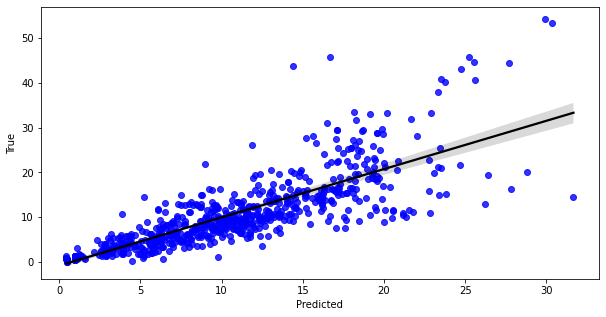

In [89]:
plt.figure(figsize=(10,5))

sns.regplot(x=reduce(lambda a,b: a+b, y_predicted_list),
            y=reduce(lambda a,b: a+b, y_true_list),
            color='blue',
            line_kws={'color':'black'})

plt.ylabel('True')
plt.xlabel('Predicted');

In [23]:
# Correlation Predicted X True

pd.DataFrame({'true':reduce(lambda a,b: a+b, y_true_list),
              'predicted': reduce(lambda a,b: a+b, y_predicted_list)}).corr()

,true,predicted
true,1.000000,0.820962
predicted,0.820962,1.000000


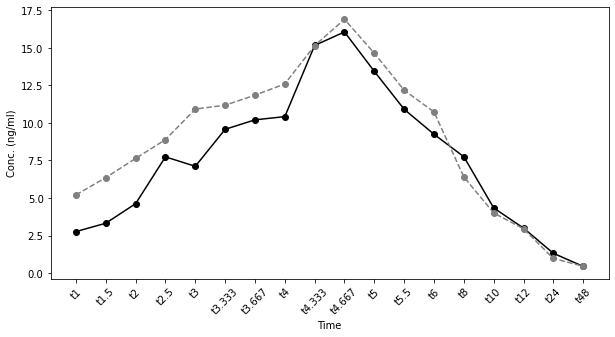

In [24]:
# Volunteer absorption profile

i=22

plt.figure(figsize=(10,5))

plt.plot(pd.DataFrame(list(y_true_list[i]), index=y_train.columns), color='black', marker='o')
plt.plot(pd.DataFrame(list(y_predicted_list[i]), index=y_train.columns), color='gray', linestyle='dashed', marker="o")
plt.ylabel('Conc. (ng/ml)')
plt.xlabel('Time')
plt.xticks(rotation=45);

## Hyperparameter fine tuning

### <font color="gray"> Random search</font>

In [68]:
# ElasticNet

# Optimizing model parameters using Random search CV:


# define evaluation procedure
cv = LeaveOneOut()


# Defining ElasticNet parameters to be optimized

parameters = {'alpha':[0.000001, 0.000001, 0.00001, 0.0001, 0.001, 0.005, 0.002,
                       0.001, 0.02, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
              'fit_intercept':[True, False],
              'l1_ratio':list(np.arange(0,1,0.05)),
              'max_iter':[100000],
              'warm_start':[True, False],
              'selection':['cyclic', 'random']}





n_iter = 100 # choosing the number o experiments to perform



# Implementing Random Search

df_metrics_hp = pd.DataFrame(columns=['Model name',
                                      'iter_number',
                                      'R2-median',
                                      'R2-std'], index=[1]) # creating empty df to fill in


model_name = 'ElasticNet' 


iter_count = 1

r2_list = []


list_parameters = [] # list to store the parameters used in each n_iter


print('\nStarting Randomized Search CV:\n')


for i in range(n_iter):
    
    hp = {k: random.sample(v,1)[0] for k, v in parameters.items()} # choosing fixed key and random values
    
    print('\nn_iter number: {}\n'.format(iter_count))
    
    print('\nParameters to evaluate in this n_iter:\n')
    
    print(hp)
    
    
    # model instance
    model = ElasticNet(alpha=hp['alpha'],
                           fit_intercept=hp['fit_intercept'],
                           l1_ratio=hp['l1_ratio'],
                           max_iter=hp['max_iter'],
                           warm_start=hp['warm_start'],
                           selection=hp['selection'])
    
    regr = MultiOutputRegressor(model, n_jobs=-1)
    
    
    print('\nModel instance:\n\n{}\n'.format(model))
    
    
    # CV splits
    
    fold_number = 1
    
    r2_list = []
    


        
    ## enumerate folds
    for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:])):
        
        X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
        Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]  
        
        
        
        print('Fold number: {}'.format(fold_number))


        # Fitting the model
        regr = regr.fit(pd.DataFrame(X_train).iloc[:,:], Y_train)
        
        # CV predictions
        y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:])
        
        y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
        y_true_list.append(list(Y_test[0])) # storing y true
        
        # evaluate model metrics on test set
        score_r2 = explained_variance_score(y_true_list[-1], y_predicted_list[-1])
        
        
        # store result
        #print('R2 score>%.3f' % score_r2)
        r2_list.append(score_r2)
        
        
        
        fold_number = fold_number +1
    

    
    
    # filling df
    df_metrics_hp.loc[i,'Model name'] = model_name
    df_metrics_hp.loc[i,'iter_number'] = iter_count
    df_metrics_hp.loc[i,'R2-median'] = round(np.median(r2_list), 3)
    df_metrics_hp.loc[i,'R2-std'] = round(np.std(r2_list), 3)
       
       
    
    
    # finishing current n_iter
    print('\nn_iter number {} status: finished\n\n'.format(iter_count))
    
    print('Results of this n_iter:\n\n{}\n\n'.format(df_metrics_hp.loc[i,:]))
    
    print('Summary of results:\n\n{}\n'.format(df_metrics_hp))
    
    print('='*110)
    
    iter_count = iter_count + 1
    
    list_parameters.append(hp)
    
    

print('\nRandomized Search CV status: completed.\n\n')

print('Final results:\n\n{}\n\n'.format(df_metrics_hp))

print('Best parameters:\n\niter_number: {}\n\n{}'.format(df_metrics_hp.sort_values(by='R2-median',ascending=False).iloc[0,1],
                                                         list_parameters[df_metrics_hp.sort_values(by='R2-median',ascending=False).index[0]]))


Starting Randomized Search CV:


n_iter number: 1


Parameters to evaluate in this n_iter:

{'alpha': 0.001, 'fit_intercept': True, 'l1_ratio': 0.45, 'max_iter': 100000, 'warm_start': True, 'selection': 'cyclic'}

Model instance:

ElasticNet(alpha=0.001, l1_ratio=0.45, max_iter=100000, warm_start=True)

Fold number: 1
Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 1 status: finished


Results of this n_iter:

Mo

Fold number: 40

n_iter number 6 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number             6
R2-median            0.28
R2-std              1.216
Name: 5, dtype: object


Summary of results:

   Model name iter_number R2-median R2-std
1  ElasticNet           2     0.675  0.596
0  ElasticNet           1     0.665  0.624
2  ElasticNet           3     0.256  0.847
3  ElasticNet           4    -0.143  4.052
4  ElasticNet           5     0.801  0.241
5  ElasticNet           6      0.28  1.216


n_iter number: 7


Parameters to evaluate in this n_iter:

{'alpha': 0.9, 'fit_intercept': True, 'l1_ratio': 0.75, 'max_iter': 100000, 'warm_start': False, 'selection': 'random'}

Model instance:

ElasticNet(alpha=0.9, l1_ratio=0.75, max_iter=100000, selection='random')

Fold number: 1
Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13

Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 11 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            11
R2-median          -0.144
R2-std              4.052
Name: 10, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
5   ElasticNet           6      0.28  1.216
6   ElasticNet           7     0.816  0.278
7   ElasticNet           8     0.266  0.944
8   ElasticNet           9    -0.143  4.052
9   ElasticNet          10     0.789  0.313
10  ElasticNet          11    -0.144  4.052


n_iter number: 12


Parameters to evaluate in this n_iter:

{'alpha': 0.1, 'fit_intercept': True, 'l1_ratio': 0.8500000000000001, 'max_iter': 100000, 'warm_start

Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 16 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            16
R2-median           0.829
R2-std              0.197
Name: 15, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.866e+01, tolerance: 1.900e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.364e-01, tolerance: 2.782e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.922e+01, tolerance: 9.271e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.386e+01, tolerance: 1.784e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 14


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.132e+01, tolerance: 7.537e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.233e+02, tolerance: 2.417e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 15


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.190e+02, tolerance: 2.788e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.299e+01, tolerance: 1.727e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.218e+02, tolerance: 2.538e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.039e+01, tolerance: 7.838e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.511e+01, tolerance: 4.261e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.359e-01, tolerance: 2.794e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.114e+01, tolerance: 1.117e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.132e+01, tolerance: 1.078e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 27


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.188e+01, tolerance: 2.919e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.323e+01, tolerance: 1.765e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 28


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.057e+02, tolerance: 2.662e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.160e+01, tolerance: 1.070e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.210e+02, tolerance: 1.776e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.222e+02, tolerance: 2.674e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.929e+01, tolerance: 9.639e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.600e+02, tolerance: 3.113e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.297e+01, tolerance: 1.767e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.644e+01, tolerance: 1.768e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 37
Fold number: 38


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.073e+01, tolerance: 1.779e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.291e+02, tolerance: 3.306e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.685e+01, tolerance: 9.236e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.913e+01, tolerance: 3.191e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.343e+02, tolerance: 3.069e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.775e-01, tolerance: 8.360e-04 Linear regression models with null weight for the l1 regularization term are more ef


n_iter number 18 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            18
R2-median           0.665
R2-std              0.622
Name: 17, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
5   ElasticNet           6      0.28  1.216
6   ElasticNet           7     0.816  0.278
7   ElasticNet           8     0.266  0.944
8   ElasticNet           9    -0.143  4.052
9   ElasticNet          10     0.789  0.313
10  ElasticNet          11    -0.144  4.052
11  ElasticNet          12      0.74  0.407
12  ElasticNet          13     0.814  0.214
13  ElasticNet          14     0.675  0.596
14  ElasticNet          15     0.835  0.186
15  ElasticNet          16     0.829  0.197
16  ElasticNet          17    -0.144  4

Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 22 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            22
R2-median           0.665
R2-std              0.623
Name: 21, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
5   ElasticNet           6      0.28  1.216
6   ElasticNet           7     0.816  0.278
7   ElasticNet     

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 26 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            26
R2-median          -0.144
R2-std              4.045
Name: 25, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.576e+01, tolerance: 2.913e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.573e+01, tolerance: 4.219e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 2


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.907e+01, tolerance: 2.252e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.034e+01, tolerance: 1.723e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 3


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.524e+01, tolerance: 1.834e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.157e+02, tolerance: 2.540e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 4
Fold number: 5


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.083e+01, tolerance: 1.817e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.626e+02, tolerance: 3.084e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 6
Fold number: 7
Fold number: 8


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.265e+02, tolerance: 3.127e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.995e+01, tolerance: 1.896e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 9


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.646e+02, tolerance: 3.108e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.909e-01, tolerance: 8.425e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 10


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.666e+01, tolerance: 2.483e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.799e+01, tolerance: 1.722e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 11


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.632e+01, tolerance: 2.489e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.178e+02, tolerance: 3.399e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.417e+01, tolerance: 2.910e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.265e+02, tolerance: 1.900e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.178e+01, tolerance: 1.118e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.329e+02, tolerance: 3.348e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 14


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.870e+02, tolerance: 8.263e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.189e+02, tolerance: 1.766e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 15


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.793e+02, tolerance: 9.069e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.641e+02, tolerance: 2.257e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 16


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.542e+02, tolerance: 1.727e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.483e+02, tolerance: 2.903e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 17


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.827e+02, tolerance: 3.165e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.787e+02, tolerance: 8.940e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 18
Fold number: 19


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.477e+01, tolerance: 1.116e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.304e+02, tolerance: 9.548e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 20
Fold number: 21
Fold number: 22


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.742e+02, tolerance: 2.885e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.918e+01, tolerance: 1.834e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 23


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.260e+02, tolerance: 1.898e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.013e+00, tolerance: 8.325e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.604e+02, tolerance: 1.746e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.567e+02, tolerance: 1.751e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.516e+01, tolerance: 5.412e-03 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.345e+02, tolerance: 3.407e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.179e+02, tolerance: 7.871e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.305e+02, tolerance: 9.658e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 27
Fold number: 28


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.870e-01, tolerance: 1.840e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.792e+01, tolerance: 4.274e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.163e+02, tolerance: 3.113e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.598e+02, tolerance: 1.748e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.780e+01, tolerance: 4.283e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.801e+02, tolerance: 3.146e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.925e+02, tolerance: 9.034e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.331e+02, tolerance: 1.889e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.344e+02, tolerance: 3.370e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.864e+01, tolerance: 1.836e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.017e+00, tolerance: 2.775e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.167e+02, tolerance: 7.806e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 34


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.615e+02, tolerance: 1.767e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.810e+02, tolerance: 3.174e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 35
Fold number: 36
Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.012e+00, tolerance: 2.743e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.179e+02, tolerance: 7.632e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.935e+02, tolerance: 3.036e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.052e+00, tolerance: 8.298e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.601e+02, tolerance: 1.768e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.959e+02, tolerance: 3.069e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40

n_iter number 27 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            27
R2-median           0.853
R2-std              0.167
Name: 26, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
5   ElasticNet           6      0.28  1.216
6   ElasticNet           7     0.816  0.278
7   ElasticNet           8     0.266  0.944
8   ElasticNet           9    -0.143  4.052
9   ElasticNet          10     0.789  0.313
10  ElasticNet          11    -0.144  4.052
11  ElasticNet          12      0.74  0.407
12  ElasticNet          13     0.814  0.214
13  ElasticNet          14     0.675  0.596
14  ElasticNet          15     0.835  0.186
15  ElasticNet          16     0.829  0.197
16  ElasticNet         

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 31 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            31
R2-median           0.219
R2-std               1.28
Name: 30, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   Elasti

Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 34 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            34
R2-median          -0.217
R2-std              2.824
Name: 33, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
5   ElasticNet           6      0.28  1.216

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 37 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            37
R2-median          -0.144
R2-std              4.052
Name: 36, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 40 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            40
R2-median          -0.165
R2-std              3.965
Name: 39, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   Elasti

Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 43 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            43
R2-median           0.789
R2-std              0.297
Name: 42, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.020e+00, tolerance: 2.801e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.110e+02, tolerance: 7.035e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 3


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.919e+01, tolerance: 1.751e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.837e+02, tolerance: 2.474e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 4


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.915e+01, tolerance: 1.837e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.347e+02, tolerance: 3.408e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 5
Fold number: 6


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.051e+02, tolerance: 3.044e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.897e+02, tolerance: 8.964e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 7


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.165e+02, tolerance: 3.117e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.337e+02, tolerance: 3.395e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 8
Fold number: 9
Fold number: 10


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.650e+02, tolerance: 2.919e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.320e+02, tolerance: 1.899e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 11


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.010e+00, tolerance: 2.770e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.161e+02, tolerance: 7.936e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.835e+02, tolerance: 3.194e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.042e+02, tolerance: 3.114e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13
Fold number: 14
Fold number: 15


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.066e-01, tolerance: 2.590e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.697e+01, tolerance: 7.921e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 16


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.868e+02, tolerance: 3.144e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.207e+02, tolerance: 3.055e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 17
Fold number: 18


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.729e+02, tolerance: 2.660e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.428e+01, tolerance: 8.940e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 19


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.118e+00, tolerance: 8.477e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.731e+01, tolerance: 7.828e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 20


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.760e+02, tolerance: 2.885e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.110e+00, tolerance: 8.449e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 21
Fold number: 22


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.687e+02, tolerance: 2.662e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.511e+02, tolerance: 2.911e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 23
Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.641e+01, tolerance: 9.015e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.063e+02, tolerance: 1.746e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.079e+02, tolerance: 1.622e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.501e+01, tolerance: 1.117e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26
Fold number: 27


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.398e+01, tolerance: 4.274e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.907e+02, tolerance: 3.050e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 28


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.170e+01, tolerance: 8.708e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.180e+02, tolerance: 1.880e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 29
Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.363e+01, tolerance: 4.283e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.759e+02, tolerance: 2.841e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.309e+01, tolerance: 1.833e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.732e+02, tolerance: 2.641e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.713e+02, tolerance: 2.617e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.470e+01, tolerance: 1.120e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.632e+01, tolerance: 9.132e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.167e+02, tolerance: 1.875e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 34
Fold number: 35


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.727e+02, tolerance: 2.661e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.142e+02, tolerance: 3.137e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 36


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.197e+02, tolerance: 3.116e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.499e+02, tolerance: 2.883e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.140e+02, tolerance: 3.161e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.409e+01, tolerance: 1.842e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38
Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.136e+02, tolerance: 3.114e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.134e+02, tolerance: 3.069e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.732e+02, tolerance: 2.652e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.077e-01, tolerance: 2.778e-04 Linear regression models with null weight for the l1 regularization term are more ef


n_iter number 44 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            44
R2-median           0.774
R2-std              0.319
Name: 43, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
5   ElasticNet           6      0.28  1.216
6   ElasticNet           7     0.816  0.278
7   ElasticNet           8     0.266  0.944
8   ElasticNet           9    -0.143  4.052
9   ElasticNet          10     0.789  0.313
10  ElasticNet          11    -0.144  4.052
11  ElasticNet          12      0.74  0.407
12  ElasticNet          13     0.814  0.214
13  ElasticNet          14     0.675  0.596
14  ElasticNet          15     0.835  0.186
15  ElasticNet          16     0.829  0.197
16  ElasticNet          17    -0.144  4

Fold number: 2


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.721e+02, tolerance: 2.558e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.533e+01, tolerance: 1.044e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 3


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.530e+01, tolerance: 1.100e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.589e+02, tolerance: 3.174e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 4


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.190e+02, tolerance: 3.084e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.695e+01, tolerance: 9.647e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 5


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.239e+02, tolerance: 2.459e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.418e+01, tolerance: 8.736e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 6


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.176e+00, tolerance: 8.474e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.599e+01, tolerance: 7.665e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 7


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.725e+01, tolerance: 7.933e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.548e+02, tolerance: 2.883e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 8
Fold number: 9


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.574e+02, tolerance: 3.179e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.069e+02, tolerance: 3.127e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 10


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.139e+02, tolerance: 1.873e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.336e+02, tolerance: 2.919e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 11


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.085e+02, tolerance: 3.159e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.984e-01, tolerance: 2.795e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.544e+01, tolerance: 9.628e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.711e+02, tolerance: 2.678e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.622e+02, tolerance: 2.898e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.561e+02, tolerance: 2.884e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 17
Fold number: 18


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.940e+02, tolerance: 2.439e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.632e+02, tolerance: 2.864e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 19


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.051e+02, tolerance: 3.103e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.022e+02, tolerance: 1.766e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 20


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.061e-01, tolerance: 2.756e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.089e+02, tolerance: 3.102e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 21


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.776e+00, tolerance: 8.449e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.658e+01, tolerance: 4.255e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 22


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.076e+02, tolerance: 1.767e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.287e-01, tolerance: 2.590e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 23
Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.880e+02, tolerance: 2.426e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.050e+02, tolerance: 2.983e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.550e+02, tolerance: 8.524e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.906e+01, tolerance: 9.579e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.899e+02, tolerance: 2.363e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.547e+02, tolerance: 2.919e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 27
Fold number: 28
Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.901e+02, tolerance: 2.452e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.445e+01, tolerance: 1.827e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.587e+02, tolerance: 2.827e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.012e+02, tolerance: 9.639e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.657e+01, tolerance: 4.258e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.436e+02, tolerance: 2.661e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.391e+02, tolerance: 2.617e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.666e+02, tolerance: 2.858e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.681e+02, tolerance: 3.130e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.645e+02, tolerance: 3.148e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 34


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.721e+01, tolerance: 9.404e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.664e+02, tolerance: 3.189e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 35
Fold number: 36


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.011e+02, tolerance: 9.689e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.602e+02, tolerance: 8.927e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.269e+01, tolerance: 1.118e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.190e+01, tolerance: 7.956e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38
Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.238e+01, tolerance: 4.263e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.665e+02, tolerance: 2.793e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.165e-01, tolerance: 2.743e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.592e+01, tolerance: 4.165e-02 Linear regression models with null weight for the l1 regularization term are more ef


n_iter number 47 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            47
R2-median           0.847
R2-std              0.172
Name: 46, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
5   ElasticNet           6      0.28  1.216
6   ElasticNet           7     0.816  0.278
7   ElasticNet           8     0.266  0.944
8   ElasticNet           9    -0.143  4.052
9   ElasticNet          10     0.789  0.313
10  ElasticNet          11    -0.144  4.052
11  ElasticNet          12      0.74  0.407
12  ElasticNet          13     0.814  0.214
13  ElasticNet          14     0.675  0.596
14  ElasticNet          15     0.835  0.186
15  ElasticNet          16     0.829  0.197
16  ElasticNet          17    -0.144  4

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 50 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            50
R2-median           0.804
R2-std              0.281
Name: 49, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   Elasti

Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 53 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            53
R2-median           0.838
R2-std              0.194
Name: 52, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   Elastic

Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 56 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            56
R2-median           0.837
R2-std              0.183
Name: 55, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 59 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            59
R2-median            0.83
R2-std              0.195
Name: 58, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0

Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 61 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            61
R2-median           0.219
R2-std               1.28
Name: 60, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
..         ...         ...       ...    ...
56  ElasticNet          57    -0.144  4.052
57  ElasticNet          58     0.275  0.895
58  ElasticNet          59      0.83  0.195
59  ElasticNet          60       0.8  0.251
60  ElasticNet          61     0.219   1.28

[61 rows x 4 columns]


n_iter number: 62


Parameters to evaluate

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 66 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            66
R2-median           0.665
R2-std              0.624
Name: 65, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   Elasti

Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 71 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            71
R2-median            0.82
R2-std              0.212
Name: 70, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.057e-01, tolerance: 2.761e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.602e+01, tolerance: 4.253e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 4


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.436e+01, tolerance: 1.817e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.657e+02, tolerance: 2.836e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 5
Fold number: 6


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.086e+02, tolerance: 1.767e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.645e+02, tolerance: 3.143e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 7


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.610e+02, tolerance: 3.113e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.622e+02, tolerance: 3.122e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 8
Fold number: 9


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.173e-01, tolerance: 2.758e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.577e+01, tolerance: 4.277e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 10


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.634e+01, tolerance: 4.253e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.919e+02, tolerance: 3.407e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 11


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.015e+02, tolerance: 9.628e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.651e+02, tolerance: 3.154e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12
Fold number: 13


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.349e+02, tolerance: 9.069e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.886e+02, tolerance: 1.727e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 14


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.054e+02, tolerance: 3.114e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.131e+01, tolerance: 3.962e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 15
Fold number: 16


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.303e+00, tolerance: 8.290e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.567e+01, tolerance: 7.685e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 17


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.151e+02, tolerance: 2.660e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.160e+02, tolerance: 3.161e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 18


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.145e+02, tolerance: 2.671e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.724e+00, tolerance: 8.336e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 19


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.315e+02, tolerance: 2.864e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.480e+02, tolerance: 9.156e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 20


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.197e+02, tolerance: 3.159e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.925e-01, tolerance: 2.590e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 21


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.287e+01, tolerance: 9.519e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.637e-01, tolerance: 2.771e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 22


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.346e+02, tolerance: 2.885e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.216e+02, tolerance: 2.850e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 23
Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.620e-01, tolerance: 2.784e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.686e+01, tolerance: 7.871e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.612e+02, tolerance: 2.488e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.157e+02, tolerance: 1.535e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26
Fold number: 27
Fold number: 28


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.141e+02, tolerance: 1.395e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.198e+02, tolerance: 3.160e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.133e+01, tolerance: 1.833e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.650e+02, tolerance: 2.450e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.466e+02, tolerance: 3.332e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.843e-01, tolerance: 2.775e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.173e+01, tolerance: 1.110e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.289e+02, tolerance: 2.817e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.181e+01, tolerance: 1.805e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.265e+02, tolerance: 3.111e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.327e+02, tolerance: 3.157e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.873e+01, tolerance: 9.404e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 34


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.086e+01, tolerance: 1.086e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.226e+01, tolerance: 9.689e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 35


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.493e+02, tolerance: 9.092e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.717e+00, tolerance: 8.444e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 36
Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.501e+02, tolerance: 3.377e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.271e+02, tolerance: 3.174e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.489e+02, tolerance: 9.134e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.450e+01, tolerance: 7.956e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.320e+02, tolerance: 2.857e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.806e+02, tolerance: 3.006e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.282e+01, tolerance: 9.307e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.861e-01, tolerance: 2.801e-04 Linear regression models with null weight for the l1 regularization term are more ef


n_iter number 73 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            73
R2-median           0.843
R2-std              0.179
Name: 72, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   ElasticNet           5     0.801  0.241
..         ...         ...       ...    ...
68  ElasticNet          69    -0.154  2.408
69  ElasticNet          70     0.218   1.28
70  ElasticNet          71      0.82  0.212
71  ElasticNet          72     0.664  0.631
72  ElasticNet          73     0.843  0.179

[73 rows x 4 columns]


n_iter number: 74


Parameters to evaluate in this n_iter:

{'alpha': 0.05, 'fit_intercept': False, 'l1_ratio': 0.55, 'max_iter': 100000, 'warm_start': False, 'selection': 'cyclic'}

Model instance:

ElasticNet(alpha=0.05, fit_interce

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 78 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            78
R2-median           0.038
R2-std              1.827
Name: 77, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   Elasti

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 83 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            83
R2-median           0.269
R2-std              1.267
Name: 82, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   Elasti

Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 88 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            88
R2-median           0.664
R2-std              0.632
Name: 87, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.052
4   Elastic

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 93 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            93
R2-median           0.664
R2-std              0.632
Name: 92, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   Elasti

Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 98 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            98
R2-median           0.209
R2-std              1.394
Name: 97, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2     0.675  0.596
0   ElasticNet           1     0.665  0.624
2   ElasticNet           3     0.256  0.847
3   ElasticNet           4    -0.143  4.

Best parameters:

n_iter number: 81


{'alpha': 0.9, 'fit_intercept': True, 'l1_ratio': 0.25, 'max_iter': 100000, 'warm_start': True, 'selection': 'random'}

R2: 0.853

In [72]:
# Saving fine tuning results

#df_metrics_hp.to_csv('/mnt/d/Gustavo/Rosu/fine_tuning_ESI_POS_results.csv')

In [69]:
df_metrics_hp

,Model name,iter_number,R2-median,R2-std
1,ElasticNet,2,0.675,0.596
0,ElasticNet,1,0.665,0.624
2,ElasticNet,3,0.256,0.847
3,ElasticNet,4,-0.143,4.052
4,ElasticNet,5,0.801,0.241
...,...,...,...,...
95,ElasticNet,96,0.194,1.365
96,ElasticNet,97,0.833,0.215
97,ElasticNet,98,0.209,1.394
98,ElasticNet,99,-0.159,3.419


In [17]:
# Use here to test a single algorithm


# define evaluation procedure
cv = LeaveOneOut()

# list to store LOOCV y splits
y_true_list = list()
y_predicted_list = list()

# lists to store metrics
r2_list = list()
mape_list = list()
rmse_list = list()
mape_list = list()
rmse_list = list()

#list to store y predictions
y_predicted_list

algorithm_to_test = ElasticNet(alpha=0.9,
                               fit_intercept=True,
                               l1_ratio=0.25,
                               max_iter=100000,
                               warm_start=True,
                               selection='random',
                               random_state=42)


i = selected_x_train.shape[1]

## enumerate folds
for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:i])):
    
    X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
    Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]
    
    

    # model instance
    regr = MultiOutputRegressor(algorithm_to_test)
    regr = regr.fit(pd.DataFrame(X_train).iloc[:,:i], Y_train)
    
    # CV predictions
    y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:i])
    
    y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
    y_true_list.append(list(Y_test[0])) # storing y true
    
    # evaluate model metrics on test set
    score_r2 = explained_variance_score(y_true_list[-1], y_predicted_list[-1])
    mape = mean_absolute_percentage_error(y_true_list[-1], y_predicted_list[-1])
    rmse = mean_squared_error(y_true_list[-1], y_predicted_list[-1], squared=False)
    
    # store result
    #print('R2 score>%.3f' % score_r2)
    r2_list.append(score_r2)
    mape_list.append(mape)
    rmse_list.append(rmse)

In [18]:
# R2 Value

print(np.median(r2_list))

# Storing R2

r2_pos = np.median(r2_list)

0.8525207659007574


In [19]:
# RMSE value

print(np.mean(rmse_list))

# Storing RMSE

rmse_pos = np.median(rmse_list)

3.38483645842645


In [20]:
# MAPE value

print(np.median(mape_list))

# Storing MAPE

mape_pos = np.median(mape_list)

0.2948404215834885


In [22]:
# getting a dataframe with predictions

df_predictions = pd.DataFrame(data=np.nan, columns=y_train.columns, index=y_train.index)

#y_predicted_list

for i, it in zip(df_predictions.index, range(len(y_predicted_list))):
    
    df_predictions.loc[i,:] = y_predicted_list[it]
    
df_predictions.head()  

,t1,t1.5,t2,t2.5,t3,t3.333,t3.667,t4,t4.333,t4.667,t5,t5.5,t6,t8,t10,t12,t24,t48
Primary ID,,,,,,,,,,,,,,,,,,
FMTB_ROS_POS_EST1_1_PRÉ 1,10.150019,14.895781,18.068538,18.875586,19.502667,18.982298,20.250159,19.882474,22.924318,24.155912,19.377791,15.888670,14.289154,9.340364,5.723614,4.002035,1.021596,0.458862
FMTB_ROS_POS_EST1_10_PRÉ 1,10.577171,16.250498,19.911265,21.094353,18.794661,19.756761,20.684913,20.130136,23.127640,19.720124,14.565488,10.828232,9.678762,6.395395,3.484513,2.703102,0.964104,0.447604
FMTB_ROS_POS_EST1_11_PRÉ 1,10.115486,13.534656,17.038454,19.513372,20.066457,20.998278,20.963702,21.290769,27.065240,30.907495,25.865983,19.519665,17.884516,12.496347,8.264063,5.952280,1.645326,0.520554
FMTB_ROS_POS_EST1_12_PRÉ 1,4.925663,6.062998,8.948615,10.989571,9.716153,10.322423,10.794987,10.637781,12.623109,12.730827,10.788264,8.559244,7.834653,5.219673,3.474306,2.878387,0.990597,0.467026
FMTB_ROS_POS_EST1_13_PRÉ 1,5.332624,5.590565,6.142367,7.122244,7.268264,7.811153,8.743217,8.154182,9.341595,9.102242,7.691294,6.702623,6.382494,3.834536,2.831693,1.842463,0.892294,0.437432


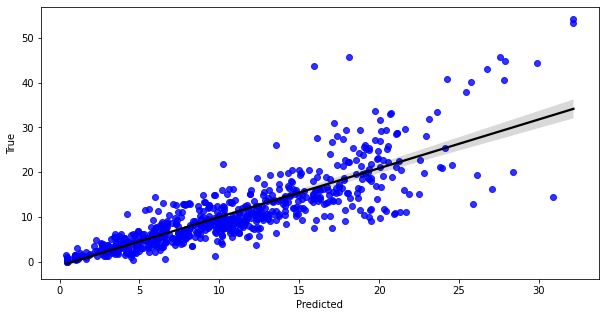

In [21]:
plt.figure(figsize=(10,5))

sns.regplot(x=reduce(lambda a,b: a+b, y_predicted_list),
            y=reduce(lambda a,b: a+b, y_true_list),
            color='blue',
            line_kws={'color':'black'})

plt.ylabel('True')
plt.xlabel('Predicted');

In [22]:
# Storing POS predictions for figure

pos_pred = reduce(lambda a,b: a+b, y_predicted_list)

In [23]:
# Correlation Predicted X True

stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
               reduce(lambda a,b: a+b, y_predicted_list)) # returns a tuple containing (correlation, p_value)

print('Pearson correlation: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
                                                      reduce(lambda a,b: a+b, y_predicted_list))[0]))

print('p value: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
                                                      reduce(lambda a,b: a+b, y_predicted_list))[1]))

Pearson correlation: 0.8551779922872271
p value: 4.280374751502197e-207


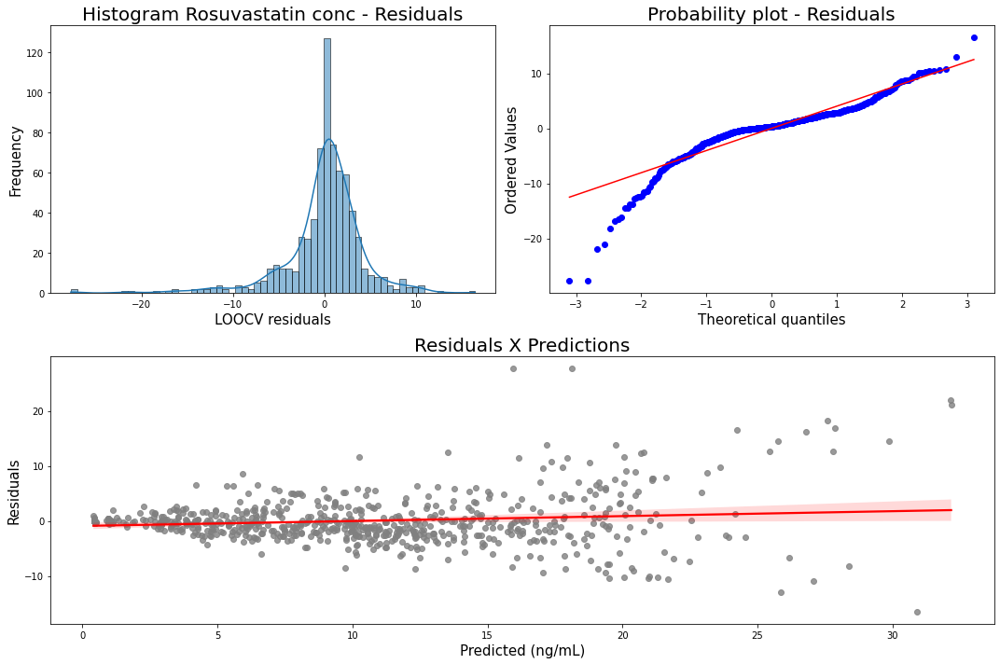

In [32]:
# defining the figure

fig = plt.figure(figsize=(15,10), facecolor='white')


# defining the axes

ax1= plt.subplot2grid((2,2), (0,0))

ax2= plt.subplot2grid((2,2), (0,1))

ax3= plt.subplot2grid((2,1), (1,0))


# Inserting data to their corresponding axes

# axes 1 - Residuals plot
sns.histplot(data=(np.array(reduce(lambda a,b: a+b, y_predicted_list))-np.array(reduce(lambda a,b: a+b, y_true_list))) , kde=True, ax=ax1)
ax1.set_title('Histogram Rosuvastatin conc - Residuals', fontdict={'color':'black', 'size':20})
ax1.set_xlabel('LOOCV residuals', fontdict={'color':'black', 'size':15})
ax1.set_ylabel('Frequency', fontdict={'color':'black', 'size':15})

#axes 2 - Probability plot
stats.probplot((np.array(reduce(lambda a,b: a+b, y_predicted_list))-np.array(reduce(lambda a,b: a+b, y_true_list))), dist='norm', rvalue=False, plot=ax2)
ax2.set_title('Probability plot - Residuals', fontdict={'color':'black', 'size':20})
ax2.set_xlabel('Theoretical quantiles', fontdict={'color':'black', 'size':15})
ax2.set_ylabel('Ordered Values', fontdict={'color':'black', 'size':15})

# axes 3 - Predicted X True
sns.regplot(x=np.array(reduce(lambda a,b: a+b, y_predicted_list)),
            y=(np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list))), 
            ci=95, 
            scatter_kws={"color": "gray"}, line_kws={"color": "red"}, fit_reg=True)
ax3.set_title('Residuals X Predictions', fontdict={'color':'black', 'size':20})
ax3.set_xlabel('Predicted (ng/mL)', fontdict={'color':'black', 'size':15})
ax3.set_ylabel('Residuals', fontdict={'color':'black', 'size':15})


fig.tight_layout()

In [24]:
# Correlation Predicted X Residuals

stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
               reduce(lambda a,b: a+b, y_predicted_list)) # returns a tuple containing (correlation, p_value)

print('Pearson correlation: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_predicted_list),
                                                      np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list)).tolist())[0]))

print('p value: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_predicted_list),
                                                      np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list)).tolist())[1]))

Pearson correlation: 0.13421921800678005
p value: 0.00030434230767268565


In [48]:
# linear regression (run it later)

#slope, intercept, r_value, p_value, std_err = stats.linregress(np.array(reduce(lambda a,b: a+b, y_predicted_list)).tolist(),
#                                                               np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list)).tolist())

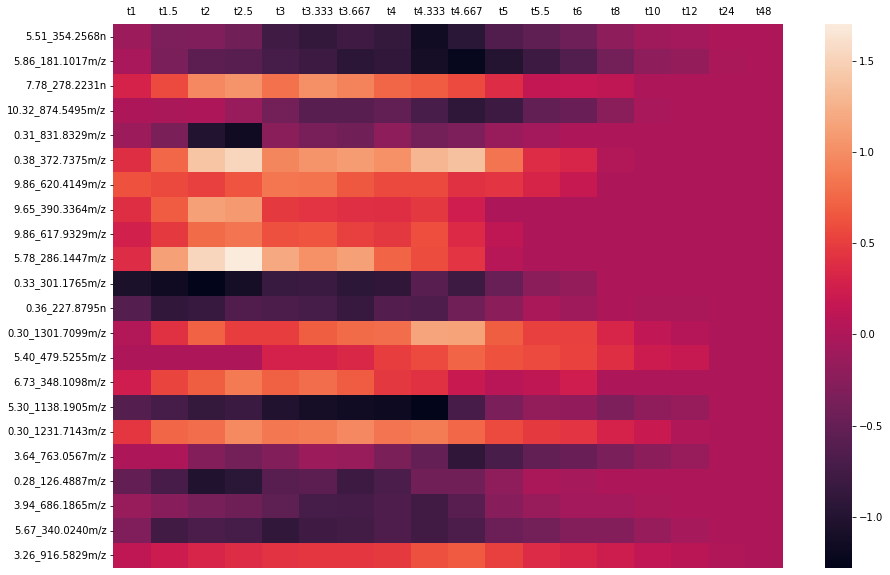

In [44]:
# Heatmap of model coefficients

# model definition 

algorithm_to_test = ElasticNet(alpha=0.9,
                               fit_intercept=True,
                               l1_ratio=0.25,
                               max_iter=100000,
                               warm_start=True,
                               selection='random',
                               random_state=42)


# model fit

algorithm_to_test.fit(selected_x_train, y_train)



# Plotting heatmap

plt.figure(figsize=(15,10))

sns.heatmap(pd.DataFrame(algorithm_to_test.coef_, columns=selected_x_train.columns, index=y_train.columns).transpose());

plt.tick_params(axis='both', which='major', labelsize=10, labelbottom = False, bottom=False, top = False, labeltop=True)



# Saving df_coef for figure

df_coef_pos = pd.DataFrame(algorithm_to_test.coef_, columns=selected_x_train.columns, index=y_train.columns)

In [45]:
df_coef_pos

,5.51_354.2568n,5.86_181.1017m/z,7.78_278.2231n,10.32_874.5495m/z,0.31_831.8329m/z,0.38_372.7375m/z,9.86_620.4149m/z,9.65_390.3364m/z,9.86_617.9329m/z,5.78_286.1447m/z,...,0.30_1301.7099m/z,5.40_479.5255m/z,6.73_348.1098m/z,5.30_1138.1905m/z,0.30_1231.7143m/z,3.64_763.0567m/z,0.28_126.4887m/z,3.94_686.1865m/z,5.67_340.0240m/z,3.26_916.5829m/z
t1,-0.115908,-0.036784,0.303265,-0.000000,-0.121563,0.392528,0.623637,0.393621,0.277309,0.376370,...,0.030084,0.000000,0.235992,-0.621581,0.443227,-0.000000,-0.521864,-0.149745,-0.322050,0.119604
t1.5,-0.329481,-0.358692,0.571832,-0.026754,-0.346680,0.747377,0.570068,0.678436,0.477388,1.118117,...,0.415974,0.000000,0.544867,-0.729629,0.742026,-0.000000,-0.713537,-0.263842,-0.755207,0.216195
t2,-0.318045,-0.568585,0.955394,-0.000000,-1.004508,1.394282,0.504024,1.128065,0.774309,1.535232,...,0.717215,-0.000000,0.691531,-0.866470,0.789181,-0.279390,-1.021112,-0.375937,-0.689697,0.322954
t2.5,-0.424801,-0.590350,1.046179,-0.140731,-1.154244,1.529337,0.636291,1.080131,0.837831,1.699375,...,0.490247,-0.000000,0.870245,-0.815288,0.969601,-0.400946,-0.950959,-0.451525,-0.723729,0.373909
t3,-0.767990,-0.721283,0.804967,-0.405048,-0.246511,0.952337,0.843808,0.477638,0.613561,1.190062,...,0.496085,0.284883,0.710216,-1.011106,0.861132,-0.293870,-0.591455,-0.546818,-0.883674,0.422458
t3.333,-0.881297,-0.808252,1.006466,-0.600133,-0.365506,1.047097,0.817622,0.438494,0.639458,1.022820,...,0.691713,0.286926,0.786558,-1.105166,0.882563,-0.117776,-0.568221,-0.725340,-0.778622,0.448598
t3.667,-0.789962,-0.935096,0.929176,-0.589087,-0.418296,1.102889,0.660069,0.406347,0.522594,1.118190,...,0.771633,0.342387,0.681728,-1.140121,0.956795,-0.146684,-0.812456,-0.737584,-0.746456,0.449319
t4,-0.866310,-0.890559,0.733902,-0.529280,-0.212606,1.015845,0.570674,0.385619,0.457918,0.733171,...,0.786494,0.495215,0.456392,-1.176809,0.831323,-0.343643,-0.693932,-0.663725,-0.673344,0.467649
t4.333,-1.146459,-1.111407,0.686760,-0.703178,-0.405094,1.281195,0.567232,0.456984,0.599719,0.585299,...,1.163857,0.579215,0.416441,-1.278591,0.873476,-0.500684,-0.428936,-0.756080,-0.759253,0.613623
t4.667,-0.941616,-1.230978,0.574356,-0.906360,-0.327510,1.365206,0.419757,0.242449,0.356386,0.435053,...,1.152618,0.733752,0.188880,-0.712057,0.746590,-0.898825,-0.417451,-0.585863,-0.673991,0.667692


# <font color="green">Data import and check - ESI (-)</font>

In [25]:
# Data import and checking

df = pd.read_csv('https://drive.google.com/u/1/uc?id=18cNXcWL_O8qWT54YE2hZQeuU8oU00c9M&export=download', encoding='latin-1')

df.head()

Primary ID  t0      t1    t1.5      t2    t2.5      t3  \
0   FMTB_ROS_NEG_EST1_1_PRÉ 1   0   3.963  10.649  15.275  21.334  21.838   
1  FMTB_ROS_NEG_EST1_10_PRÉ 1   0  16.350  20.172  24.839  28.861  29.402   
2  FMTB_ROS_NEG_EST1_11_PRÉ 1   0   4.488   6.477   7.581   9.058   9.858   
3  FMTB_ROS_NEG_EST1_12_PRÉ 1   0   6.934   7.796   9.980  10.115   9.045   
4  FMTB_ROS_NEG_EST1_13_PRÉ 1   0  11.647  11.897  11.228  12.916  12.768   

   t3.333  t3.667      t4  t4.333  t4.667      t5    t5.5      t6      t8  \
0  23.760  22.721  23.052  28.178  25.489  20.783  18.079  16.833  12.338   
1  33.573  32.952  29.256  31.950  27.283  20.534  16.280  14.954   8.936   
2  10.864  10.565  11.140  16.210  14.443  12.929  11.704   9.096   5.791   
3  10.646  10.074   9.560  11.089   9.293   7.527   6.693   5.200   3.173   
4  12.868  11.601  12.802  12.762  13.330  11.210   8.624   8.395   4.142   

     t10    t12    t24    t48    t72    Cmax  AUClast  8.42_1562.1277m/z  \
0  7.755  5.378  1.197  0.312  0.000  28.178  218.631           0.225370   
1  6.166  4.018  1.302  0.678  0.311  33.573  250.282           0.161022   
2  3.424  2.110  0.619  0.204  0.000  16.210  109.506           0.148616   
3  1.710  1.400  0.618  0.000  0.000  11.089   76.060           0.146848   
4  2.325  1.579  1.004  0.998  0.540  13.330  145.164           0.117544   

   6.48_1605.9970m/z  5.40_532.0377m/z  0.36_1158.2420m/z  0.28_702.7730m/z  \
0           0.141611          0.287875           0.227349          0.129962   
1           0.129152          0.385910           0.185915          0.204067   
2           0.206605          0.240161           0.201431          0.125608   
3           0.111748          0.383022           0.210697          0.193060   
4           0.221418          0.255417           0.237148          0.127275   

   7.27_411.3828m/z  0.30_1109.3108n  0.30_1162.2781n  7.87_1696.0852m/z  \
0          0.161788         0.147115         0.126081           0.249930   
1          0.195144         0.200405         0.183546           0.193217   
2          0.167877         0.050750         0.035189           0.144549   
3          0.313450         0.147290         0.201644           0.137769   
4          0.196918         0.130559         0.104679           0.149428   

   10.80_279.6138m/z  5.32_52.8654m/z  0.36_1174.2883m/z  0.30_1034.2937n  \
0           0.094970         0.184281           0.229366         0.146059   
1           0.241812         0.148582           0.218137         0.189542   
2           0.254545         0.236413           0.181075         0.161854   
3           0.253644         0.192995           0.206148         0.197096   
4           0.254976         0.241636           0.192633         0.151453   

   0.28_1142.6516m/z  10.39_1636.1421m/z  10.46_1557.1500m/z  0.30_1136.2752n  \
0           0.083120            0.354956            0.335943         0.022738   
1           0.179475            0.230722            0.236630         0.182656   
2           0.122373            0.267778            0.232823         0.155853   
3           0.151455            0.293495            0.290796         0.178353   
4           0.100445            0.227051            0.202931         0.130097   

   4.93_1433.5379m/z  3.85_1410.2592n  7.75_1516.1052m/z  0.28_424.8487m/z  \
0           0.173664         0.090757           0.197017          0.130033   
1           0.138192         0.114452           0.194612          0.187287   
2           0.167368         0.112217           0.297580          0.125114   
3           0.142281         0.135455           0.299123          0.191866   
4           0.174069         0.142664           0.232037          0.129857   

   6.62_1377.8661m/z  0.28_308.9068m/z  0.30_1425.7036m/z  6.73_1666.9602m/z  \
0           0.146397          0.147378           0.136056           0.191404   
1           0.120934          0.224918           0.167085           0.204735   
2           0.188785          0.141778       

In [26]:
# Guardar o nome das amostras em uma lista e o nome das variáveis em outra lista

df_copy = df.copy()

df_copy2 = df.copy()

lista_nome_amostras = list(df_copy['Primary ID'])

lista_nome_variaveis_x = list(df_copy2.iloc[:,23:].columns)

lista_nome_variaveis_y = list(df_copy2.columns[2:20])

In [27]:
# Transformar o nome das amostras em índice:

df = df.set_index('Primary ID')
# https://www.geeksforgeeks.org/how-to-convert-dataframe-column-into-an-index-in-python-pandas/

df.head()

t0      t1    t1.5      t2    t2.5      t3  \
Primary ID                                                               
FMTB_ROS_NEG_EST1_1_PRÉ 1    0   3.963  10.649  15.275  21.334  21.838   
FMTB_ROS_NEG_EST1_10_PRÉ 1   0  16.350  20.172  24.839  28.861  29.402   
FMTB_ROS_NEG_EST1_11_PRÉ 1   0   4.488   6.477   7.581   9.058   9.858   
FMTB_ROS_NEG_EST1_12_PRÉ 1   0   6.934   7.796   9.980  10.115   9.045   
FMTB_ROS_NEG_EST1_13_PRÉ 1   0  11.647  11.897  11.228  12.916  12.768   

                            t3.333  t3.667      t4  t4.333  t4.667      t5  \
Primary ID                                                                   
FMTB_ROS_NEG_EST1_1_PRÉ 1   23.760  22.721  23.052  28.178  25.489  20.783   
FMTB_ROS_NEG_EST1_10_PRÉ 1  33.573  32.952  29.256  31.950  27.283  20.534   
FMTB_ROS_NEG_EST1_11_PRÉ 1  10.864  10.565  11.140  16.210  14.443  12.929   
FMTB_ROS_NEG_EST1_12_PRÉ 1  10.646  10.074   9.560  11.089   9.293   7.527   
FMTB_ROS_NEG_EST1_13_PRÉ 1  12.868  11.601  12.802  12.762  13.330  11.210   

                              t5.5      t6      t8    t10    t12    t24  \
Primary ID                                                                
FMTB_ROS_NEG_EST1_1_PRÉ 1   18.079  16.833  12.338  7.755  5.378  1.197   
FMTB_ROS_NEG_EST1_10_PRÉ 1  16.280  14.954   8.936  6.166  4.018  1.302   
FMTB_ROS_NEG_EST1_11_PRÉ 1  11.704   9.096   5.791  3.424  2.110  0.619   
FMTB_ROS_NEG_EST1_12_PRÉ 1   6.693   5.200   3.173  1.710  1.400  0.618   
FMTB_ROS_NEG_EST1_13_PRÉ 1   8.624   8.395   4.142  2.325  1.579  1.004   

                              t48    t72    Cmax  AUClast  8.42_1562.1277m/z  \
Primary ID                                                                     
FMTB_ROS_NEG_EST1_1_PRÉ 1   0.312  0.000  28.178  218.631           0.225370   
FMTB_ROS_NEG_EST1_10_PRÉ 1  0.678  0.311  33.573  250.282           0.161022   
FMTB_ROS_NEG_EST1_11_PRÉ 1  0.204  0.000  16.210  109.506           0.148616   
FMTB_ROS_NEG_EST1_12_PRÉ 1  0.000  0.000  11.089   76.060           0.146848   
FMTB_ROS_NEG_EST1_13_PRÉ 1  0.998  0.540  13.330  145.164           0.117544   

                            6.48_1605.9970m/z  5.40_532.0377m/z  \
Primary ID                                                        
FMTB_ROS_NEG_EST1_1_PRÉ 1            0.141611          0.287875   
FMTB_ROS_NEG_EST1_10_PRÉ 1           0.129152          0.385910   
FMTB_ROS_NEG_EST1_11_PRÉ 1           0.206605          0.240161   
FMTB_ROS_NEG_EST1_12_PRÉ 1           0.111748          0.383022   
FMTB_ROS_NEG_EST1_13_PRÉ 1           0.221418          0.255417   

                            0.36_1158.2420m/z  0.28_702.7730m/z  \
Primary ID                                                        
FMTB_ROS_NEG_EST1_1_PRÉ 1            0.227349          0.129962   
FMTB_ROS_NEG_EST1_10_PRÉ 1           0.185915          0.204067   
FMTB_ROS_NEG_EST1_11_PRÉ 1           0.201431          0.125608   
FMTB_ROS_NEG_EST1_12_PRÉ 1           0.210697          0.193060   
FMTB_ROS_NEG_EST1_13_PRÉ 1           0.237148          0.127275   

                            7.27_411.3828m/z  0.30_1109.3108n  \
Primary ID                                                      
FMTB_ROS_NEG_EST1_1_PRÉ 1           0.161788         0.147115   
FMTB_ROS_NEG_EST1_10_PRÉ 1          0.195144         0.200405   
FMTB_ROS_NEG_EST1_11_PRÉ 1          0.167877         0.050750   
FMTB_ROS_NEG_EST1_12_PRÉ 1          0.313450         0.147290   
FMTB_ROS_NEG_EST1_13_PRÉ 1          0.196918         0.130559   

                            0.30_1162.2781n  7.87_1696.0852m/z  \
Primary ID                                                       
FMTB_ROS_NEG_EST1_1_PRÉ 1          0.126081           0.249930   
FMTB_ROS_NEG_EST1_10_PRÉ 1         0.183546           0.193217   
FMTB_ROS_NEG_EST1_11_PRÉ 1         0.035189           0.144549   
FMTB_ROS_NEG_EST1_12_PRÉ 1         0.201644           0.137769   
FMTB_ROS_NEG_EST1_13_PRÉ 1         0.104679           0.149428   

                

In [28]:
df.shape

(40, 2468)

In [29]:
# Tipo das variáveis

df.dtypes

t0                    int64
t1                  float64
t1.5                float64
t2                  float64
t2.5                float64
                     ...   
0.63_576.1298n      float64
0.54_329.0377m/z    float64
5.61_448.3061m/z    float64
6.53_481.3154n      float64
7.01_526.3501m/z    float64
Length: 2468, dtype: object

In [30]:
# Verificar dados faltantes

df.isna().sum()

t0                  0
t1                  0
t1.5                0
t2                  0
t2.5                0
                   ..
0.63_576.1298n      0
0.54_329.0377m/z    0
5.61_448.3061m/z    0
6.53_481.3154n      0
7.01_526.3501m/z    0
Length: 2468, dtype: int64

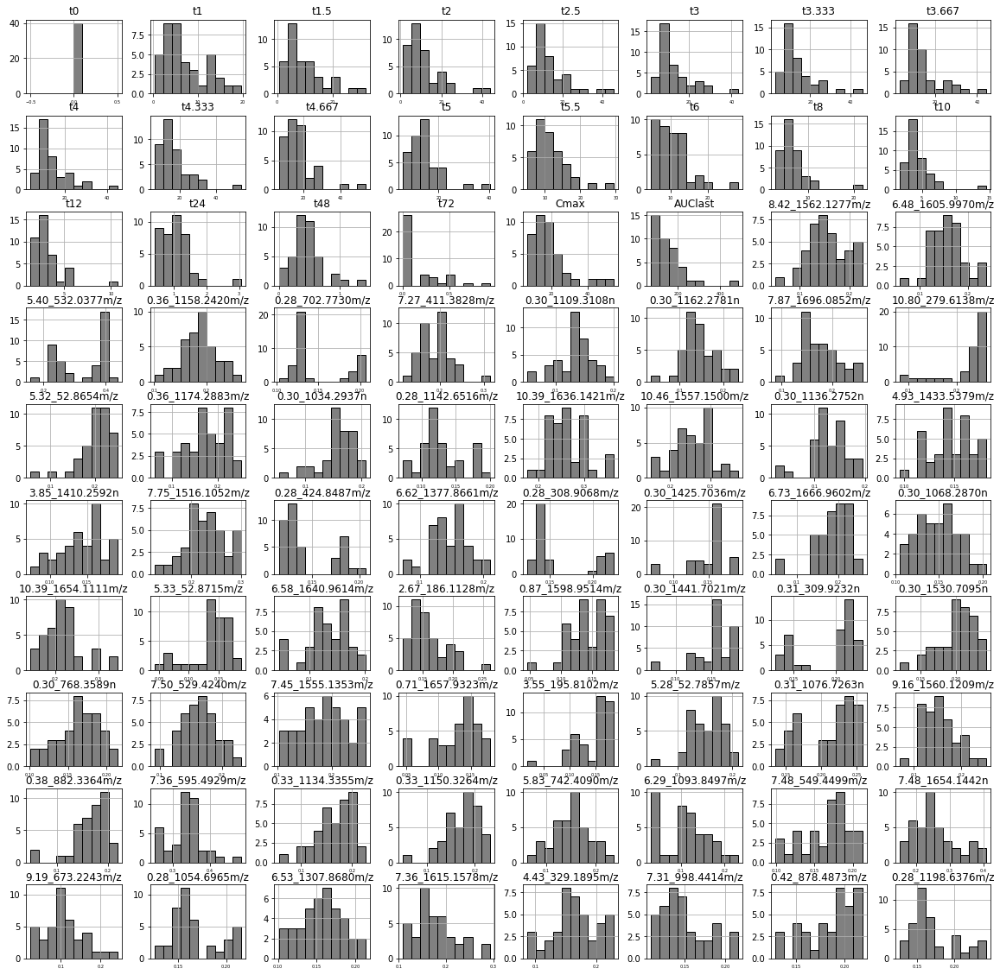

In [12]:
# Verificar distribuição dos features

df.iloc[:,0:80].hist(figsize=(20,20), xlabelsize=5, layout=(10,8), color='grey', edgecolor='black')

plt.show()

# Data preparation

In [31]:
# Data preparation for Machine Learning model(X and Y):


## features

x_train = df.drop(['t0', 't1', 't1.5', 't2', 't2.5', 't3', 't3.333', 't3.667', 't4',
                   't4.333', 't4.667', 't5', 't5.5', 't6', 't8', 't10', 't12', 't24',
                   't48', 't72', 'Cmax', 'AUClast'], axis=1)

## response variable

y_train = df[['t1', 't1.5', 't2', 't2.5', 't3', 't3.333', 't3.667', 't4',
              't4.333', 't4.667', 't5', 't5.5', 't6', 't8', 't10', 't12', 't24',
              't48']].copy()

In [32]:
# Data scaling

transformer = RobustScaler().fit(x_train)

transformer

RobustScaler()

In [33]:
transformer.transform(x_train)

array([[ 1.61075515, -0.27184728, -0.57148667, ..., -0.80102629,
         0.04039482,  0.66720118],
       [ 0.28291082, -0.54089802,  0.10423814, ..., -0.60311855,
        -0.14330291, -1.13618882],
       [ 0.02690851,  1.13169104, -0.90036445, ...,  0.04678667,
         0.0518432 , -0.9231174 ],
       ...,
       [ 0.54477358, -2.09614045,  0.4531254 , ..., -0.98148586,
        -0.14617562, -0.07689513],
       [ 1.24482826, -0.91019225,  0.12559169, ...,  0.4789803 ,
        -0.08518361,  2.20926299],
       [ 0.00270323, -0.52001576,  0.19746866, ..., -0.37394511,
         0.85695181, -1.48518597]])

In [34]:
# Store scaled data in a variable

scaled_x_train = transformer.transform(x_train)

In [35]:
# X data:

scaled_x_train = pd.DataFrame(scaled_x_train)

scaled_x_train.columns = lista_nome_variaveis_x #renome

scaled_x_train['Primary ID'] = lista_nome_amostras # in

scaled_x_train = scaled_x_train.set_index('Primary ID')

In [36]:
scaled_x_train.head()

8.42_1562.1277m/z  6.48_1605.9970m/z  \
Primary ID                                                         
FMTB_ROS_NEG_EST1_1_PRÉ 1            1.610755          -0.271847   
FMTB_ROS_NEG_EST1_10_PRÉ 1           0.282911          -0.540898   
FMTB_ROS_NEG_EST1_11_PRÉ 1           0.026909           1.131691   
FMTB_ROS_NEG_EST1_12_PRÉ 1          -0.009575          -0.916736   
FMTB_ROS_NEG_EST1_13_PRÉ 1          -0.614273           1.451576   

                            5.40_532.0377m/z  0.36_1158.2420m/z  \
Primary ID                                                        
FMTB_ROS_NEG_EST1_1_PRÉ 1          -0.571487           0.982934   
FMTB_ROS_NEG_EST1_10_PRÉ 1          0.104238          -0.080417   
FMTB_ROS_NEG_EST1_11_PRÉ 1         -0.900364           0.317781   
FMTB_ROS_NEG_EST1_12_PRÉ 1          0.084332           0.555581   
FMTB_ROS_NEG_EST1_13_PRÉ 1         -0.795210           1.234412   

                            0.28_702.7730m/z  7.27_411.3828m/z  \
Primary ID                                                       
FMTB_ROS_NEG_EST1_1_PRÉ 1           0.009192         -0.764159   
FMTB_ROS_NEG_EST1_10_PRÉ 1          1.098207          0.012149   
FMTB_ROS_NEG_EST1_11_PRÉ 1         -0.054792         -0.622447   
FMTB_ROS_NEG_EST1_12_PRÉ 1          0.936453          2.765532   
FMTB_ROS_NEG_EST1_13_PRÉ 1         -0.030295          0.053436   

                            0.30_1109.3108n  0.30_1162.2781n  \
Primary ID                                                     
FMTB_ROS_NEG_EST1_1_PRÉ 1          0.376998        -0.452108   
FMTB_ROS_NEG_EST1_10_PRÉ 1         2.080861         1.096511   
FMTB_ROS_NEG_EST1_11_PRÉ 1        -2.704118        -2.901549   
FMTB_ROS_NEG_EST1_12_PRÉ 1         0.382594         1.584232   
FMTB_ROS_NEG_EST1_13_PRÉ 1        -0.152353        -1.028869   

                            7.87_1696.0852m/z  10.80_279.6138m/z  \
Primary ID                                                         
FMTB_ROS_NEG_EST1_1_PRÉ 1            1.815849          -6.090621   
FMTB_ROS_NEG_EST1_10_PRÉ 1           0.640018          -0.048859   
FMTB_ROS_NEG_EST1_11_PRÉ 1          -0.369017           0.475035   
FMTB_ROS_NEG_EST1_12_PRÉ 1          -0.509586           0.437964   
FMTB_ROS_NEG_EST1_13_PRÉ 1          -0.267860           0.492769   

                            5.32_52.8654m/z  0.36_1174.2883m/z  \
Primary ID                                                       
FMTB_ROS_NEG_EST1_1_PRÉ 1         -0.771533           0.790821   
FMTB_ROS_NEG_EST1_10_PRÉ 1        -1.871249           0.631310   
FMTB_ROS_NEG_EST1_11_PRÉ 1         0.834406           0.104835   
FMTB_ROS_NEG_EST1_12_PRÉ 1        -0.503096           0.461003   
FMTB_ROS_NEG_EST1_13_PRÉ 1         0.995302           0.269019   

                            0.30_1034.2937n  0.28_1142.6516m/z  \
Primary ID                                                       
FMTB_ROS_NEG_EST1_1_PRÉ 1         -0.378512          -0.989723   
FMTB_ROS_NEG_EST1_10_PRÉ 1         0.983919           1.559183   
FMTB_ROS_NEG_EST1_11_PRÉ 1         0.116385           0.048648   
FMTB_ROS_NEG_EST1_12_PRÉ 1         1.220604           0.817962   
FMTB_ROS_NEG_EST1_13_PRÉ 1        -0.209505          -0.531420   

                            10.39_1636.1421m/z  10.46_1557.1500m/z  \
Primary ID                                                           
FMTB_ROS_NEG_EST1_1_PRÉ 1             1.598135            1.291678   
FMTB_ROS_NEG_EST1_10_PRÉ 1           -0.499217           -0.322735   
FMTB_ROS_NEG_EST1_11_PRÉ 1            0.126372           -0.384620   
FMTB_ROS_NEG_EST1_12_PRÉ 1            0.560533            0.557777   
FMTB_ROS_NEG_EST1_13_PRÉ 1           -0.561192           -0.870539   

                            0.30_1136.2752n  4.93_1433.5379m/z  \
Primary ID                                                       
FMTB_ROS_NEG_EST1_1_PRÉ 1         -2.649002           1.103940   
FMTB_ROS_NEG_EST1_10_PRÉ 1         1.443955          -0.251557   
FMTB_ROS_NE

In [37]:
y_train.shape

(40, 18)

# Feature selection

## RFE algorithm for feature selection

In [20]:
# Evaluating RFE for different number of features

list_features = []
list_r2 = []

for i in range(2, len(scaled_x_train.columns)+1):
    
    print('Now evaluating feature number: {}'.format(i))
    
    # Instantiating RFE object
    rfe = RFE(estimator=ElasticNet(), n_features_to_select=i)
    
    # Fitting RFE object
    rfe.fit(scaled_x_train, y_train)
    
    # CV predictions
    y_cv_predicted = cross_val_predict(rfe, scaled_x_train[rfe.feature_names_in_[rfe.support_]], y_train, cv=LeaveOneOut())
    
    # calculating CV R2
    r2_value = r2_score(y_train,
                    y_cv_predicted)
    # appending r2 value to list
    list_r2.append(r2_value)
    
    # appending feature set
    list_features.append(list(rfe.feature_names_in_[rfe.support_]))
    
    print('Features selected for this evaluation: {}'.format(list(rfe.feature_names_in_[rfe.support_])))
    print('R2: {}\n'.format(r2_value))
    
print('Evaluation status: DONE')   

Now evaluating feature number: 2
Features selected for this evaluation: ['0.36_1158.2420m/z', '7.19_1256.9127m/z']
R2: 0.18750498622187667

Now evaluating feature number: 3
Features selected for this evaluation: ['0.36_1158.2420m/z', '7.19_1256.9127m/z', '0.33_180.0628n']
R2: 0.2645158241960902

Now evaluating feature number: 4
Features selected for this evaluation: ['0.36_1158.2420m/z', '7.19_1256.9127m/z', '6.73_1534.0014m/z', '0.33_180.0628n']
R2: 0.2991902690572142

Now evaluating feature number: 5
Features selected for this evaluation: ['0.36_1158.2420m/z', '0.30_1465.7052n', '7.19_1256.9127m/z', '6.73_1534.0014m/z', '0.33_180.0628n']
R2: 0.297934260113651

Now evaluating feature number: 6
Features selected for this evaluation: ['0.36_1158.2420m/z', '7.75_1516.1052m/z', '0.30_1465.7052n', '7.19_1256.9127m/z', '6.73_1534.0014m/z', '0.33_180.0628n']
R2: 0.31713513427011025

Now evaluating feature number: 7
Features selected for this evaluation: ['0.36_1158.2420m/z', '7.75_1516.1052m

Features selected for this evaluation: ['0.36_1158.2420m/z', '7.75_1516.1052m/z', '0.30_1465.7052n', '0.30_1439.7326n', '6.81_1292.9120m/z', '6.69_606.2142n', '0.58_1673.2484m/z', '0.33_1145.3529n', '7.15_1273.9369n', '7.19_1256.9127m/z', '6.73_1534.0014m/z', '0.30_1018.3095n', '6.57_1563.9456n', '6.97_222.9378m/z', '7.80_1170.7581m/z', '0.53_1178.0931n', '0.66_1377.3429n', '6.71_616.3512m/z', '3.67_1105.5651n', '6.39_286.2135n', '4.31_439.1598m/z', '6.45_447.2739m/z', '0.33_180.0628n', '6.53_427.2148m/z', '0.36_217.0297m/z']
R2: 0.3924868140149667

Now evaluating feature number: 26
Features selected for this evaluation: ['0.36_1158.2420m/z', '7.75_1516.1052m/z', '0.30_1465.7052n', '0.30_1439.7326n', '6.81_1292.9120m/z', '6.69_606.2142n', '0.58_1673.2484m/z', '0.33_1145.3529n', '7.15_1273.9369n', '0.58_1191.1731m/z', '7.19_1256.9127m/z', '6.73_1534.0014m/z', '0.30_1018.3095n', '6.57_1563.9456n', '6.97_222.9378m/z', '7.80_1170.7581m/z', '0.53_1178.0931n', '0.66_1377.3429n', '6.71_616.35

Features selected for this evaluation: ['0.36_1158.2420m/z', '7.75_1516.1052m/z', '0.30_1465.7052n', '0.30_1439.7326n', '6.81_1292.9120m/z', '6.69_606.2142n', '0.58_1673.2484m/z', '0.33_1145.3529n', '7.03_1546.0585n', '7.15_1273.9369n', '0.58_1191.1731m/z', '7.19_1256.9127m/z', '6.73_1534.0014m/z', '6.73_1242.8965m/z', '0.30_1018.3095n', '6.57_1563.9456n', '6.97_222.9378m/z', '6.62_714.2583m/z', '7.80_1170.7581m/z', '7.31_902.5155m/z', '7.54_1527.0700m/z', '0.53_1178.0931n', '4.58_434.2192n', '12.17_417.9939m/z', '0.66_1377.3429n', '6.71_616.3512m/z', '5.68_716.2648m/z', '3.67_1105.5651n', '7.78_1173.8082n', '6.39_286.2135n', '1.65_369.0020m/z', '4.31_439.1598m/z', '6.45_447.2739m/z', '0.33_180.0628n', '7.59_708.2784m/z', '6.53_427.2148m/z', '0.36_217.0297m/z']
R2: 0.37672915282069225

Now evaluating feature number: 38
Features selected for this evaluation: ['0.36_1158.2420m/z', '7.75_1516.1052m/z', '0.30_1465.7052n', '0.30_1439.7326n', '6.81_1292.9120m/z', '6.69_606.2142n', '0.58_1673

KeyboardInterrupt: 

Best features:

['0.36_1158.2420m/z', '7.75_1516.1052m/z', '0.30_1465.7052n', '0.30_1439.7326n', '6.81_1292.9120m/z', '6.69_606.2142n', '0.58_1673.2484m/z', '0.33_1145.3529n', '7.15_1273.9369n', '0.58_1191.1731m/z', '7.19_1256.9127m/z', '6.73_1534.0014m/z', '0.30_1018.3095n', '6.57_1563.9456n', '6.97_222.9378m/z', '7.80_1170.7581m/z', '0.53_1178.0931n', '0.66_1377.3429n', '6.71_616.3512m/z', '3.67_1105.5651n', '6.39_286.2135n', '1.65_369.0020m/z', '4.31_439.1598m/z', '6.45_447.2739m/z', '0.33_180.0628n', '7.59_708.2784m/z', '6.53_427.2148m/z', '0.36_217.0297m/z']

Score: 0.4030277244203721

# Machine learning 

## Initial evaluation

In [38]:
# selected features

rfe_features = ['0.36_1158.2420m/z', '7.75_1516.1052m/z', '0.30_1465.7052n', '0.30_1439.7326n',
                '6.81_1292.9120m/z', '6.69_606.2142n', '0.58_1673.2484m/z', '0.33_1145.3529n',
                '7.15_1273.9369n', '0.58_1191.1731m/z', '7.19_1256.9127m/z', '6.73_1534.0014m/z',
                '0.30_1018.3095n', '6.57_1563.9456n', '6.97_222.9378m/z', '7.80_1170.7581m/z',
                '0.53_1178.0931n', '0.66_1377.3429n', '6.71_616.3512m/z', '3.67_1105.5651n',
                '6.39_286.2135n', '1.65_369.0020m/z', '4.31_439.1598m/z', '6.45_447.2739m/z',
                '0.33_180.0628n', '7.59_708.2784m/z', '6.53_427.2148m/z', '0.36_217.0297m/z']


# scaled_x_train with selected features

selected_x_train = scaled_x_train[rfe_features]

In [22]:
# Modeling - RFE features

# Evaluating models for RFE-selected features (new_X)

#models_to_evaluate = [LinearRegression(n_jobs=-1),
#                      Lasso(random_state=42),
#                      ElasticNet(random_state=42),
#                      RandomForestRegressor(random_state=42, n_jobs=-1),
#                      PLSRegression(max_iter=1000)]
#
#model_names = ['Linear Regression', 'LASSO', 'ElasticNet', 'Random Forest', 'PLS']

# define evaluation procedure
cv = LeaveOneOut()

# list to store LOOCV y splits
y_true_list = list()
y_predicted_list = list()

# lists to store metrics
r2_list = list()

#list to store y predictions
y_predicted_list



models_to_evaluate = [LinearRegression(n_jobs=-1),
                      Lasso(random_state=42),
                      ElasticNet(random_state=42),
                      RandomForestRegressor(random_state=42, n_jobs=-1),
                      xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100,
                                       eta=0.01, max_depth=10, subsample=0.7, colsample_bytree=0.9),
                      SVR(kernel='linear')]

model_names = ['Linear Regression', 'LASSO', 'ElasticNet', 'Random Forest', 'XGBoost', 'SVR']


df_models = pd.DataFrame(index=model_names, columns=[i for i in range(1, selected_x_train.shape[1]+1)])


for i in range(1, selected_x_train.shape[1]+1):
    
    for it, iterator in zip(model_names, models_to_evaluate):
        
        ## enumerate folds
        for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:i])):
            
            X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
            Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]
            
            
        
            # model instance
            regr = MultiOutputRegressor(iterator)
            regr = regr.fit(pd.DataFrame(X_train).iloc[:,:i], Y_train)
            
            # CV predictions
            y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:i])
            
            y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
            y_true_list.append(list(Y_test[0])) # storing y true
            
            # evaluate model metrics on test set
            r2_value = explained_variance_score(y_true_list[-1],
                                                y_predicted_list[-1])
            
            # store r2
            r2_list.append(r2_value)
            
        # filling df_linear_models
        df_models.loc[it, i] = np.mean(r2_list)
        print(df_models)
            
        r2_list  = []    

    
df_models.style.highlight_max(axis=1)

                         1    2    3    4    5    6    7    8    9    10   11  \
Linear Regression  0.545846  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO                   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest           NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost                 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
SVR                     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   

                    12   13   14   15   16   17   18   19   20   21   22   23  \
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

                         1         2    3    4    5    6    7    8    9    10  \
Linear Regression  0.545846  0.595023  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              0.546591       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.544214       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.529637       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            0.363518       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
SVR                0.600186       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   

                    11   12   13   14   15   16   17   18   19   20   21   22  \
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

                         1         2         3    4    5    6    7    8    9   \
Linear Regression  0.545846  0.595023  0.593639  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              0.546591  0.582452       NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.544214  0.585172       NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.529637  0.607772       NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            0.363518  0.267638       NaN  NaN  NaN  NaN  NaN  NaN  NaN   
SVR                0.600186  0.638591       NaN  NaN  NaN  NaN  NaN  NaN  NaN   

                    10   11   12   13   14   15   16   17   18   19   20   21  \
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

                         1         2         3         4    5    6    7    8   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  NaN  NaN  NaN  NaN   
LASSO              0.546591  0.582452  0.564526       NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.544214  0.585172  0.570521       NaN  NaN  NaN  NaN  NaN   
Random Forest      0.529637  0.607772  0.585582       NaN  NaN  NaN  NaN  NaN   
XGBoost            0.363518  0.267638  0.536949       NaN  NaN  NaN  NaN  NaN   
SVR                0.600186  0.638591  0.608691       NaN  NaN  NaN  NaN  NaN   

                    9    10   11   12   13   14   15   16   17   18   19   20  \
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

                         1         2         3         4         5    6    7   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  NaN  NaN   
LASSO              0.546591  0.582452  0.564526  0.573962       NaN  NaN  NaN   
ElasticNet         0.544214  0.585172  0.570521  0.589486       NaN  NaN  NaN   
Random Forest      0.529637  0.607772  0.585582  0.648164       NaN  NaN  NaN   
XGBoost            0.363518  0.267638  0.536949  0.650901       NaN  NaN  NaN   
SVR                0.600186  0.638591  0.608691  0.629736       NaN  NaN  NaN   

                    8    9    10   11   12   13   14   15   16   17   18   19  \
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436       NaN   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539       NaN   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403       NaN   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513       NaN   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282       NaN   

                    7    8    9    10   11   12   13   14   15   16   17   18  \
Linear Regression  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            NaN  NaN

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7    8    9    10   11   12   13   14   15   16   17  \
Linear Regression  0.668491  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO                   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet              NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest           NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost                 NaN

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7    8    9    10   11   12   13   14   15   16   17  \
Linear Regression  0.668491  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO               0.64511  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.666714  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.634955  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8    9    10   11   12   13   14   15   16  \
Linear Regression  0.668491  0.665725  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO               0.64511  0.632095  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.666714  0.674917  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.634955  0.559676  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9    10   11   12   13   14   15  \
Linear Regression  0.668491  0.665725   0.67257  NaN  NaN  NaN  NaN  NaN  NaN   
LASSO               0.64511  0.632095  0.645111  NaN  NaN  NaN  NaN  NaN  NaN   
ElasticNet         0.666714  0.674917  0.688366  NaN  NaN  NaN  NaN  NaN  NaN   
Random Forest      0.634955  0.559676  0.547276  NaN  NaN  NaN  NaN  NaN  NaN   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10   11   12   13   14  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  NaN  NaN  NaN  NaN   
LASSO               0.64511  0.632095  0.645111  0.625428  NaN  NaN  NaN  NaN   
ElasticNet         0.666714  0.674917  0.688366  0.681938  NaN  NaN  NaN  NaN   
Random Forest      0.634955  0.559676  0.547276       NaN  NaN  NaN  NaN  NaN   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11   12   13  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  NaN  NaN   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  NaN  NaN   
ElasticNet         0.666714  0.674917  0.688366  0.681938       NaN  NaN  NaN   
Random Forest      0.634955  0.559676  0.547276  0.513234       NaN  NaN  NaN   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098       NaN   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331       NaN   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039       NaN   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

                         1         2         3         4         5         6   \
Linear Regression  0.545846  0.595023  0.593639  0.605065  0.605861  0.628377   
LASSO              0.546591  0.582452  0.564526  0.573962  0.589436  0.612868   
ElasticNet         0.544214  0.585172  0.570521  0.589486  0.620539  0.640689   
Random Forest      0.529637  0.607772  0.585582  0.648164  0.657403  0.645742   
XGBoost            0.363518  0.267638  0.536949  0.650901  0.655513  0.656112   
SVR                0.600186  0.638591  0.608691  0.629736  0.628282   0.66576   

                         7         8         9         10        11        12  \
Linear Regression  0.668491  0.665725   0.67257  0.649692  0.624878  0.637863   
LASSO               0.64511  0.632095  0.645111  0.625428  0.620098  0.639843   
ElasticNet         0.666714  0.674917  0.688366  0.681938  0.685331  0.711042   
Random Forest      0.634955  0.559676  0.547276  0.513234  0.539039  0.576103   
XGBoost            0.641966

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28
Linear Regression,0.545846,0.595023,0.593639,0.605065,0.605861,0.628377,0.668491,0.665725,0.672570,0.649692,0.624878,0.637863,0.611893,0.604100,0.637801,0.683225,0.665490,0.650411,0.699147,0.696738,0.670117,0.667368,0.682993,0.646514,0.585431,0.533178,0.414324,0.414200
LASSO,0.546591,0.582452,0.564526,0.573962,0.589436,0.612868,0.645110,0.632095,0.645111,0.625428,0.620098,0.639843,0.632613,0.625913,0.668898,0.678768,0.674401,0.673298,0.680762,0.685224,0.683659,0.679995,0.676343,0.670621,0.687626,0.673190,0.660284,0.659936
ElasticNet,0.544214,0.585172,0.570521,0.589486,0.620539,0.640689,0.666714,0.674917,0.688366,0.681938,0.685331,0.711042,0.702372,0.702105,0.731744,0.764315,0.758043,0.752629,0.766716,0.771251,0.783823,0.789406,0.802461,0.801318,0.809645,0.799812,0.795723,0.795442
Random Forest,0.529637,0.607772,0.585582,0.648164,0.657403,0.645742,0.634955,0.559676,0.547276,0.513234,0.539039,0.576103,0.515447,0.524663,0.532264,0.549480,0.576188,0.591034,0.602727,0.605784,0.608038,0.608193,0.615704,0.613988,0.622354,0.619198,0.621574,0.621161
XGBoost,0.363518,0.267638,0.536949,0.650901,0.655513,0.656112,0.641966,0.631609,0.642379,0.568804,0.591029,0.636904,0.559427,0.626946,0.608503,0.623059,0.617829,0.632484,0.643222,0.655452,0.648619,0.630850,0.648444,0.663334,0.656487,0.651282,0.600313,0.640508
SVR,0.600186,0.638591,0.608691,0.629736,0.628282,0.665760,0.700951,0.686654,0.714892,0.700269,0.688807,0.618136,0.624805,0.618871,0.701926,0.760527,0.747592,0.735802,0.756763,0.743666,0.727313,0.719349,0.760815,0.740678,0.708032,0.713707,0.728572,0.742177


In [107]:
# Use here to test a single algorithm


# define evaluation procedure
cv = LeaveOneOut()

# list to store LOOCV y splits
y_true_list = list()
y_predicted_list = list()

# lists to store metrics
r2_list = list()
mape_list = list()
rmse_list = list()
mape_list = list()
rmse_list = list()

#list to store y predictions
y_predicted_list

algorithm_to_test = ElasticNet(random_state=42)

i = 25

## enumerate folds
for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:i])):
    
    X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
    Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]
    
    

    # model instance
    regr = MultiOutputRegressor(algorithm_to_test)
    regr = regr.fit(pd.DataFrame(X_train).iloc[:,:i], Y_train)
    
    # CV predictions
    y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:i])
    
    y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
    y_true_list.append(list(Y_test[0])) # storing y true
    
    # evaluate model metrics on test set
    score_r2 = explained_variance_score(y_true_list[-1], y_predicted_list[-1])
    mape = mean_absolute_percentage_error(y_true_list[-1], y_predicted_list[-1])
    rmse = mean_squared_error(y_true_list[-1], y_predicted_list[-1], squared=False)
    
    # store result
    #print('R2 score>%.3f' % score_r2)
    r2_list.append(score_r2)
    mape_list.append(mape)
    rmse_list.append(rmse)

In [108]:
# R2 Value

np.median(r2_list)

0.8301215908382349

In [109]:
# RMSE value

np.mean(rmse_list)

3.41121696419343

In [110]:
# MAPE value

np.median(mape_list)

0.3108933509997623

In [111]:
# getting a dataframe with predictions

df_predictions = pd.DataFrame(data=np.nan, columns=y_train.columns, index=y_train.index)

#y_predicted_list

for i, it in zip(df_predictions.index, range(len(y_predicted_list))):
    
    df_predictions.loc[i,:] = y_predicted_list[it]
    
df_predictions.head()  

,t1,t1.5,t2,t2.5,t3,t3.333,t3.667,t4,t4.333,t4.667,t5,t5.5,t6,t8,t10,t12,t24,t48
Primary ID,,,,,,,,,,,,,,,,,,
FMTB_ROS_NEG_EST1_1_PRÉ 1,9.114104,11.628928,13.992856,15.762628,16.748284,16.766152,17.242332,17.201498,20.245473,21.968856,17.588109,13.455514,12.227202,8.229295,4.957875,3.357603,1.042667,0.459026
FMTB_ROS_NEG_EST1_10_PRÉ 1,8.994443,12.991041,17.397403,18.933306,16.089421,16.810776,18.634470,18.150571,21.778910,20.608202,16.827387,13.233094,11.242627,6.940368,4.288794,3.212821,1.039974,0.449641
FMTB_ROS_NEG_EST1_11_PRÉ 1,6.616062,8.957593,9.994049,11.439247,12.835819,13.418147,14.050231,13.675311,17.559754,18.376484,15.631393,12.740032,11.274038,7.759066,4.918079,3.749299,1.057487,0.461795
FMTB_ROS_NEG_EST1_12_PRÉ 1,5.754584,7.686812,8.139249,9.650689,11.163609,11.443509,12.412719,12.428820,14.182970,13.112783,11.142903,9.687940,8.780132,6.085732,4.084415,3.078209,1.057513,0.467026
FMTB_ROS_NEG_EST1_13_PRÉ 1,8.423612,11.627416,15.053784,16.544047,15.294380,15.796190,16.779636,15.425342,16.576071,14.973232,11.216006,9.560685,8.860213,6.425732,4.518531,3.304039,1.047615,0.441436


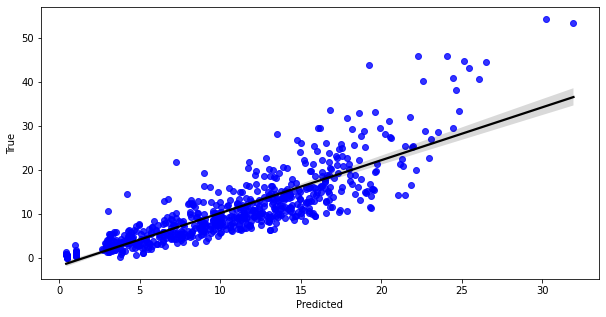

In [88]:
plt.figure(figsize=(10,5))

sns.regplot(x=reduce(lambda a,b: a+b, y_predicted_list),
            y=reduce(lambda a,b: a+b, y_true_list),
            color='blue',
            line_kws={'color':'black'})

plt.ylabel('True')
plt.xlabel('Predicted');

In [89]:
# Correlation Predicted X True

pd.DataFrame({'true':reduce(lambda a,b: a+b, y_true_list),
              'predicted': reduce(lambda a,b: a+b, y_predicted_list)}).corr()

,true,predicted
true,1.000000,0.863548
predicted,0.863548,1.000000


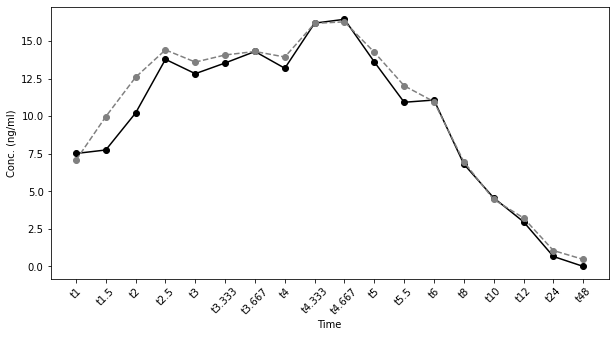

In [90]:
# Volunteer absorption profile

i=9

plt.figure(figsize=(10,5))

plt.plot(pd.DataFrame(list(y_true_list[i]), index=y_train.columns), color='black', marker='o')
plt.plot(pd.DataFrame(list(y_predicted_list[i]), index=y_train.columns), color='gray', linestyle='dashed', marker="o")
plt.ylabel('Conc. (ng/ml)')
plt.xlabel('Time')
plt.xticks(rotation=45);

## Hyperparameter fine tuning

### <font color="gray"> Random search</font>

In [24]:
# ElasticNet

# Optimizing model parameters using Random search CV:


# define evaluation procedure
cv = LeaveOneOut()


# Defining ElasticNet parameters to be optimized

parameters = {'alpha':[0.000001, 0.000001, 0.00001, 0.0001, 0.001, 0.005, 0.002,
                       0.001, 0.02, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
              'fit_intercept':[True, False],
              'l1_ratio':list(np.arange(0,1,0.05)),
              'max_iter':[100000],
              'warm_start':[True, False],
              'selection':['cyclic', 'random']}





n_iter = 100 # choosing the number o experiments to perform



# Implementing Random Search

df_metrics_hp = pd.DataFrame(columns=['Model name',
                                      'iter_number',
                                      'R2-median',
                                      'R2-std'], index=[1]) # creating empty df to fill in


model_name = 'ElasticNet' 


iter_count = 1

r2_list = []


list_parameters = [] # list to store the parameters used in each n_iter


print('\nStarting Randomized Search CV:\n')


for i in range(n_iter):
    
    hp = {k: random.sample(v,1)[0] for k, v in parameters.items()} # choosing fixed key and random values
    
    print('\nn_iter number: {}\n'.format(iter_count))
    
    print('\nParameters to evaluate in this n_iter:\n')
    
    print(hp)
    
    
    # model instance
    model = ElasticNet(alpha=hp['alpha'],
                           fit_intercept=hp['fit_intercept'],
                           l1_ratio=hp['l1_ratio'],
                           max_iter=hp['max_iter'],
                           warm_start=hp['warm_start'],
                           selection=hp['selection'])
    
    regr = MultiOutputRegressor(model, n_jobs=-1)
    
    
    print('\nModel instance:\n\n{}\n'.format(model))
    
    
    # CV splits
    
    fold_number = 1
    
    r2_list = []
    


        
    ## enumerate folds
    for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:])):
        
        X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
        Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]  
        
        
        
        print('Fold number: {}'.format(fold_number))


        # Fitting the model
        regr = regr.fit(pd.DataFrame(X_train).iloc[:,:], Y_train)
        
        # CV predictions
        y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:])
        
        y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
        y_true_list.append(list(Y_test[0])) # storing y true
        
        # evaluate model metrics on test set
        score_r2 = explained_variance_score(y_true_list[-1], y_predicted_list[-1])
        
        
        # store result
        #print('R2 score>%.3f' % score_r2)
        r2_list.append(score_r2)
        
        
        
        fold_number = fold_number +1
    

    
    
    # filling df
    df_metrics_hp.loc[i,'Model name'] = model_name
    df_metrics_hp.loc[i,'iter_number'] = iter_count
    df_metrics_hp.loc[i,'R2-median'] = round(np.median(r2_list), 3)
    df_metrics_hp.loc[i,'R2-std'] = round(np.std(r2_list), 3)
       
       
    
    
    # finishing current n_iter
    print('\nn_iter number {} status: finished\n\n'.format(iter_count))
    
    print('Results of this n_iter:\n\n{}\n\n'.format(df_metrics_hp.loc[i,:]))
    
    print('Summary of results:\n\n{}\n'.format(df_metrics_hp))
    
    print('='*110)
    
    iter_count = iter_count + 1
    
    list_parameters.append(hp)
    
    

print('\nRandomized Search CV status: completed.\n\n')

print('Final results:\n\n{}\n\n'.format(df_metrics_hp))

print('Best parameters:\n\niter_number: {}\n\n{}'.format(df_metrics_hp.sort_values(by='R2-median',ascending=False).iloc[0,1],
                                                         list_parameters[df_metrics_hp.sort_values(by='R2-median',ascending=False).index[0]]))


Starting Randomized Search CV:


n_iter number: 1


Parameters to evaluate in this n_iter:

{'alpha': 0.001, 'fit_intercept': True, 'l1_ratio': 0.75, 'max_iter': 100000, 'warm_start': True, 'selection': 'cyclic'}

Model instance:

ElasticNet(alpha=0.001, l1_ratio=0.75, max_iter=100000, warm_start=True)

Fold number: 1
Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 1 status: finished


Results of this n_iter:

Mo

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.123e+02, tolerance: 8.706e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.038e+03, tolerance: 9.616e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.094e+03, tolerance: 9.481e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.614e+02, tolerance: 6.133e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.203e+03, tolerance: 1.018e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.001e+02, tolerance: 8.927e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 14


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.292e+02, tolerance: 2.852e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.452e+02, tolerance: 8.987e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 15


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.701e+02, tolerance: 2.089e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.460e+03, tolerance: 1.340e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.254e+02, tolerance: 8.506e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.154e+02, tolerance: 9.228e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.452e+02, tolerance: 5.003e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.131e+03, tolerance: 9.591e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 27


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.691e+02, tolerance: 1.764e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.135e+03, tolerance: 9.583e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 28


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.455e+02, tolerance: 5.075e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.114e+03, tolerance: 8.002e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 29
Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.655e+02, tolerance: 6.203e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.670e+02, tolerance: 8.534e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.724e+03, tolerance: 1.397e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.245e+02, tolerance: 2.865e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.880e+02, tolerance: 2.214e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.377e+03, tolerance: 1.135e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.832e+00, tolerance: 5.014e-03 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.491e+02, tolerance: 5.101e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.021e+03, tolerance: 1.067e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.806e+00, tolerance: 5.178e-03 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.252e+03, tolerance: 1.040e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.290e+03, tolerance: 1.074e+00 Linear regression models with null weight for the l1 regularization term are more ef


n_iter number 4 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number             4
R2-median          -0.318
R2-std              2.792
Name: 3, dtype: object


Summary of results:

   Model name iter_number R2-median R2-std
1  ElasticNet           2    -0.717  5.071
0  ElasticNet           1     0.745  0.813
2  ElasticNet           3    -0.038  1.532
3  ElasticNet           4    -0.318  2.792


n_iter number: 5


Parameters to evaluate in this n_iter:

{'alpha': 0.0001, 'fit_intercept': True, 'l1_ratio': 0.8, 'max_iter': 100000, 'warm_start': True, 'selection': 'random'}

Model instance:

ElasticNet(alpha=0.0001, l1_ratio=0.8, max_iter=100000, selection='random',
           warm_start=True)

Fold number: 1
Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold n

Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 10 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            10
R2-median          -0.004
R2-std              1.212
Name: 9, dtype: object


Summary of results:

   Model name iter_number R2-median R2-std
1  ElasticNet           2    -0.717  5.071
0  ElasticNet           1     0.745  0.813
2  ElasticNet           3    -0.038  1.532
3  ElasticNet           4    -0.318  2.792
4 

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 15 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            15
R2-median           0.871
R2-std              0.164
Name: 14, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   Elasti

Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 19 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            19
R2-median           0.748
R2-std              0.796
Name: 18, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           

Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 23 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            23
R2-median           0.011
R2-std              1.142
Name: 22, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   ElasticNet           5

Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 27 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            27
R2-median          -0.565
R2-std              4.749
Name: 26, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           

Fold number: 40

n_iter number 30 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            30
R2-median           0.871
R2-std              0.136
Name: 29, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   ElasticNet           5     0.736  0.857
5   ElasticNet           6    -0.707  5.059
6   ElasticNet           7    -0.379  3.656
7   ElasticNet           8    -0.591   4.79
8   ElasticNet           9    -0.724  5.086
9   ElasticNet          10    -0.004  1.212
10  ElasticNet          11    -0.448  3.184
11  ElasticNet          12     0.878  0.126
12  ElasticNet          13    -0.724  5.085
13  ElasticNet          14      0.87   0.12
14  ElasticNet          15     0.871  0.164
15  ElasticNet          16     0.868  0.145
16  ElasticNet         

Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 34 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            34
R2-median           0.735
R2-std              0.861
Name: 33, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   Elastic

Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 37 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            37
R2-median          -0.491
R2-std              4.539
Name: 36, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 40 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            40
R2-median           0.809
R2-std              0.339
Name: 39, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   Elasti

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 43 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            43
R2-median           0.023
R2-std              1.299
Name: 42, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1

Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 46 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            46
R2-median            0.83
R2-std              0.248
Name: 45, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 49 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            49
R2-median          -0.385
R2-std              2.772
Name: 48, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 52 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            52
R2-median           0.745
R2-std              0.813
Name: 51, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   Elasti

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 55 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            55
R2-median          -0.565
R2-std              4.749
Name: 54, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1

Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 58 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            58
R2-median           0.815
R2-std              0.366
Name: 57, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   ElasticNet           5

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 61 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            61
R2-median          -0.723
R2-std              5.084
Name: 60, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1

Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 66 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            66
R2-median          -0.379
R2-std              3.656
Name: 65, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   Elasti

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.123e+03, tolerance: 9.444e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.705e+02, tolerance: 8.532e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 2


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.845e+01, tolerance: 5.070e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.320e+03, tolerance: 9.707e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 3


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.726e+03, tolerance: 1.438e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.948e+01, tolerance: 4.795e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 4


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.117e+03, tolerance: 9.855e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.265e+03, tolerance: 1.069e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 5
Fold number: 6
Fold number: 7


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.078e+03, tolerance: 9.789e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.947e+00, tolerance: 5.023e-03 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 8
Fold number: 9


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.926e+02, tolerance: 1.058e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.561e+02, tolerance: 8.454e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 10
Fold number: 11
Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.870e+00, tolerance: 1.102e-03 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.504e+02, tolerance: 4.979e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.244e+03, tolerance: 1.056e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.279e+02, tolerance: 2.838e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 14
Fold number: 15


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.961e+02, tolerance: 9.492e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.019e+02, tolerance: 9.190e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 16


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.589e+03, tolerance: 1.468e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.645e+02, tolerance: 6.324e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 17
Fold number: 18


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.136e+03, tolerance: 9.788e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.556e+03, tolerance: 1.396e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 19
Fold number: 20


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.506e+02, tolerance: 5.083e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.897e+02, tolerance: 2.704e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 21


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.130e+03, tolerance: 9.728e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.823e+00, tolerance: 5.185e-03 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 22
Fold number: 23
Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.267e+03, tolerance: 1.002e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.975e+02, tolerance: 2.715e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.619e+02, tolerance: 6.629e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+03, tolerance: 9.808e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.271e+03, tolerance: 1.050e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.153e+02, tolerance: 2.481e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 27


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.565e+02, tolerance: 6.329e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.691e+02, tolerance: 1.764e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 28


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.577e+00, tolerance: 9.069e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.863e+02, tolerance: 2.182e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.292e+02, tolerance: 2.803e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.272e+02, tolerance: 2.868e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.029e+03, tolerance: 1.067e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.819e+00, tolerance: 5.009e-03 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.749e+03, tolerance: 1.465e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.258e+03, tolerance: 1.067e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.341e+03, tolerance: 1.052e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.154e+03, tolerance: 9.778e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33
Fold number: 34


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.115e+03, tolerance: 9.780e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.929e+01, tolerance: 5.051e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 35
Fold number: 36
Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.624e+02, tolerance: 8.023e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.937e+01, tolerance: 5.089e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.028e+02, tolerance: 4.976e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.283e+02, tolerance: 5.095e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.860e+00, tolerance: 1.061e-03 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.862e+02, tolerance: 2.231e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.795e+00, tolerance: 1.101e-03 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.178e+02, tolerance: 9.204e-02 Linear regression models with null weight for the l1 regularization term are more ef


n_iter number 71 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            71
R2-median          -0.318
R2-std              2.792
Name: 70, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   ElasticNet           5     0.736  0.857
..         ...         ...       ...    ...
66  ElasticNet          67     0.813   0.31
67  ElasticNet          68     -0.08  1.779
68  ElasticNet          69     0.746   0.81
69  ElasticNet          70    -0.004  1.278
70  ElasticNet          71    -0.318  2.792

[71 rows x 4 columns]


n_iter number: 72


Parameters to evaluate in this n_iter:

{'alpha': 0.001, 'fit_intercept': True, 'l1_ratio': 0.0, 'max_iter': 100000, 'warm_start': False, 'selection': 'random'}

Model instance:

ElasticNet(alpha=0.001, l1_ratio=0.

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.016e+03, tolerance: 1.031e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.280e+02, tolerance: 2.867e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 2


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.189e+02, tolerance: 8.771e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+03, tolerance: 9.763e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 3


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.711e+03, tolerance: 1.469e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.618e+02, tolerance: 8.526e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 4


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.127e+02, tolerance: 5.466e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.741e+00, tolerance: 1.103e-03 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 5


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.289e+02, tolerance: 2.866e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.191e+03, tolerance: 1.051e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 6


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.072e+03, tolerance: 9.728e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.136e+03, tolerance: 1.129e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 7


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.034e+03, tolerance: 9.998e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.306e+02, tolerance: 6.293e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 8
Fold number: 9


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.550e+02, tolerance: 2.170e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.244e+03, tolerance: 1.056e+00 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 10
Fold number: 11


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.120e+03, tolerance: 9.706e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.584e+00, tolerance: 5.162e-03 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.677e+02, tolerance: 6.214e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.655e+00, tolerance: 1.070e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.277e+02, tolerance: 2.839e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.981e+01, tolerance: 5.014e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 14


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.836e+00, tolerance: 1.722e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.608e+01, tolerance: 8.263e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 15


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.003e+00, tolerance: 1.808e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.428e+01, tolerance: 1.766e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 16


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.076e+01, tolerance: 3.391e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.316e+00, tolerance: 1.773e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 17


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.962e+01, tolerance: 2.903e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.030e+01, tolerance: 3.400e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 18


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.894e+01, tolerance: 7.921e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.318e+01, tolerance: 2.816e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 19
Fold number: 20


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.713e+01, tolerance: 1.751e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.738e+01, tolerance: 9.688e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 21


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.981e+01, tolerance: 3.088e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.838e+01, tolerance: 3.154e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 22
Fold number: 23


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.338e-01, tolerance: 8.248e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.085e+01, tolerance: 4.256e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.302e-01, tolerance: 8.449e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.545e+01, tolerance: 7.871e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.102e+01, tolerance: 4.261e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.857e+01, tolerance: 2.445e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26
Fold number: 27
Fold number: 28


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.828e+01, tolerance: 6.441e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.018e+01, tolerance: 2.884e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.348e+01, tolerance: 9.151e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.060e+01, tolerance: 1.820e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.515e+01, tolerance: 3.190e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.461e+01, tolerance: 2.452e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31
Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.123e+01, tolerance: 4.278e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.766e+01, tolerance: 3.130e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33
Fold number: 34
Fold number: 35


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.015e+01, tolerance: 1.875e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.907e+01, tolerance: 2.900e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 36


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.991e+01, tolerance: 3.174e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.839e+01, tolerance: 2.919e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.289e+01, tolerance: 2.882e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.950e+01, tolerance: 3.114e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.066e+01, tolerance: 1.900e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.989e+01, tolerance: 3.178e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.046e+01, tolerance: 9.695e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.936e+00, tolerance: 1.838e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40

n_iter number 72 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            72
R2-median           0.749
R2-std              0.792
Name: 71, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   ElasticNet           5     0.736  0.857
..         ...         ...       ...    ...
67  ElasticNet          68     -0.08  1.779
68  ElasticNet          69     0.746   0.81
69  ElasticNet          70    -0.004  1.278
70  ElasticNet          71    -0.318  2.792
71  ElasticNet          72     0.749  0.792

[72 rows x 4 columns]


n_iter number: 73


Parameters to evaluate in this n_iter:

{'alpha': 0.1, 'fit_intercept': True, 'l1_ratio': 0.9500000000000001, 'max_iter': 100000, 'warm_start': False, 'selection': 'random'}

Model instance:

Elasti

Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 77 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            77
R2-median           0.752
R2-std              0.774
Name: 76, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           

/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.699e+00, tolerance: 1.117e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.147e+01, tolerance: 2.471e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 2


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.815e+01, tolerance: 2.663e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.117e-01, tolerance: 8.337e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 3


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.445e+01, tolerance: 3.384e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.125e+01, tolerance: 3.174e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 4


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.362e+01, tolerance: 2.474e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.363e+01, tolerance: 2.452e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 5


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.776e+01, tolerance: 2.919e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.675e+01, tolerance: 3.041e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.073e+01, tolerance: 3.113e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.971e+01, tolerance: 1.767e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 10


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.689e-01, tolerance: 2.758e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.001e+01, tolerance: 4.277e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 11


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.459e+01, tolerance: 2.475e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.250e+01, tolerance: 2.885e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.636e+00, tolerance: 1.901e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.834e+01, tolerance: 2.607e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.398e+01, tolerance: 2.961e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.399e+00, tolerance: 1.108e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 14
Fold number: 15


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.603e+01, tolerance: 1.766e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.185e-01, tolerance: 8.290e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 16


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.475e+01, tolerance: 3.158e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.794e+01, tolerance: 3.103e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 17


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.659e+01, tolerance: 9.695e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.771e+01, tolerance: 3.055e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 18


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.588e+01, tolerance: 2.679e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.519e+01, tolerance: 3.177e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.332e+01, tolerance: 1.763e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.917e-01, tolerance: 2.784e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 24


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.679e+01, tolerance: 1.622e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.889e-01, tolerance: 8.372e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 25
Fold number: 26


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.340e-01, tolerance: 1.840e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.405e+01, tolerance: 7.892e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 27
Fold number: 28
Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.351e+01, tolerance: 2.866e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.679e-01, tolerance: 2.615e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.266e+01, tolerance: 2.869e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.815e+00, tolerance: 1.843e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.594e+01, tolerance: 2.452e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.945e+01, tolerance: 9.071e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.594e+01, tolerance: 2.440e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.602e+01, tolerance: 2.656e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33
Fold number: 34
Fold number: 35


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.036e+01, tolerance: 3.411e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.569e+01, tolerance: 2.424e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 36


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.043e+01, tolerance: 2.851e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.306e+00, tolerance: 1.839e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.978e+00, tolerance: 1.118e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.589e+01, tolerance: 2.639e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.220e+01, tolerance: 4.281e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.146e+01, tolerance: 9.134e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 39


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.087e+01, tolerance: 3.006e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.574e+01, tolerance: 2.865e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 40


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.612e+00, tolerance: 1.817e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.811e+01, tolerance: 1.844e-01 Linear regression models with null weight for the l1 regularization term are more ef


n_iter number 78 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            78
R2-median           0.816
R2-std              0.363
Name: 77, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   ElasticNet           5     0.736  0.857
..         ...         ...       ...    ...
73  ElasticNet          74    -0.594  4.251
74  ElasticNet          75     0.081   1.55
75  ElasticNet          76    -0.723  5.085
76  ElasticNet          77     0.752  0.774
77  ElasticNet          78     0.816  0.363

[78 rows x 4 columns]


n_iter number: 79


Parameters to evaluate in this n_iter:

{'alpha': 0.001, 'fit_intercept': True, 'l1_ratio': 0.30000000000000004, 'max_iter': 100000, 'warm_start': True, 'selection': 'random'}

Model instance:

ElasticNet(alpha=0.0

Fold number: 2
Fold number: 3
Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 83 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            83
R2-median           0.736
R2-std              0.855
Name: 82, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1

Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 88 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            88
R2-median            -0.7
R2-std              5.041
Name: 87, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   Elastic

Fold number: 2
Fold number: 3
Fold number: 4


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.022e-01, tolerance: 2.788e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.586e+00, tolerance: 1.835e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 5


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.444e+01, tolerance: 2.452e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.504e+01, tolerance: 3.117e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 6


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.357e+00, tolerance: 1.114e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.715e+01, tolerance: 9.647e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 7
Fold number: 8


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.433e+01, tolerance: 9.675e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.051e+01, tolerance: 1.767e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 9


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.284e+01, tolerance: 7.959e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.689e+01, tolerance: 9.628e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 10


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.347e+00, tolerance: 1.066e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.759e+01, tolerance: 9.136e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 11


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.394e+01, tolerance: 4.253e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.553e+01, tolerance: 1.767e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 12


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.282e+01, tolerance: 4.284e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.576e+01, tolerance: 9.657e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 13
Fold number: 14


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.550e+01, tolerance: 2.483e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.491e+01, tolerance: 9.271e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.223e+00, tolerance: 1.802e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.631e+00, tolerance: 1.116e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 19


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.631e+00, tolerance: 1.094e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.248e+01, tolerance: 2.816e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 20


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.250e+01, tolerance: 3.159e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.816e-01, tolerance: 2.590e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 21


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.009e+01, tolerance: 1.898e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.739e+01, tolerance: 3.154e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 22


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.145e+01, tolerance: 2.885e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.307e+00, tolerance: 1.834e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 23


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.507e+01, tolerance: 7.871e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.248e+01, tolerance: 2.712e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 24
Fold number: 25


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.413e+01, tolerance: 3.059e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.072e+01, tolerance: 1.746e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 26
Fold number: 27


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.499e+01, tolerance: 9.658e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.733e+01, tolerance: 3.401e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 28
Fold number: 29


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.485e+01, tolerance: 1.765e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.406e+01, tolerance: 3.190e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 30


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.178e-01, tolerance: 8.391e-04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.799e+01, tolerance: 7.950e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 31


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.705e+01, tolerance: 7.806e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.250e+01, tolerance: 2.861e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 32


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.612e+01, tolerance: 9.404e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.754e+01, tolerance: 3.114e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 33


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.175e+01, tolerance: 2.656e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.397e-01, tolerance: 2.801e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 34


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.822e+01, tolerance: 7.948e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.729e+01, tolerance: 2.851e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 35


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.800e+01, tolerance: 2.893e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.984e+01, tolerance: 9.092e-02 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 36


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.339e+01, tolerance: 2.640e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.763e+01, tolerance: 2.919e-01 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 37


/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.909e+00, tolerance: 1.779e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/home/ms4life_lab/.pyenv/versions/3.8.0/envs/Rosu/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.985e-01, tolerance: 8.298e-04 Linear regression models with null weight for the l1 regularization term are more ef

Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 93 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            93
R2-median           0.735
R2-std              0.862
Name: 92, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           4    -0.318  2.792
4   ElasticNet           5     0.736  0.857
..         ...         ...       ...    ...
88  ElasticNet          89     0.042  1.351
89  ElasticNet          90     0.852  0.144
90  ElasticNet          91     0.756  0.758
91  ElasticNet          92     0.736  0.855
92  ElasticNet          93     0.735  0.862

[93 rows x 4 columns]


n_iter number: 94


Parameters to evaluate in this n_iter:

{'alpha': 0.4, 'fit_intercept': True, 'l1_ratio': 0.25, 'max_iter': 100000, 'warm_start': True, 'selection': 'cyclic'}

Model 

Fold number: 4
Fold number: 5
Fold number: 6
Fold number: 7
Fold number: 8
Fold number: 9
Fold number: 10
Fold number: 11
Fold number: 12
Fold number: 13
Fold number: 14
Fold number: 15
Fold number: 16
Fold number: 17
Fold number: 18
Fold number: 19
Fold number: 20
Fold number: 21
Fold number: 22
Fold number: 23
Fold number: 24
Fold number: 25
Fold number: 26
Fold number: 27
Fold number: 28
Fold number: 29
Fold number: 30
Fold number: 31
Fold number: 32
Fold number: 33
Fold number: 34
Fold number: 35
Fold number: 36
Fold number: 37
Fold number: 38
Fold number: 39
Fold number: 40

n_iter number 98 status: finished


Results of this n_iter:

Model name     ElasticNet
iter_number            98
R2-median           0.822
R2-std              0.237
Name: 97, dtype: object


Summary of results:

    Model name iter_number R2-median R2-std
1   ElasticNet           2    -0.717  5.071
0   ElasticNet           1     0.745  0.813
2   ElasticNet           3    -0.038  1.532
3   ElasticNet           

Best parameters:

n_iter number: 60


{'alpha': 0.5, 'fit_intercept': True, 'l1_ratio': 0.1, 'max_iter': 100000, 'warm_start': True, 'selection': 'random'}


ElasticNet(alpha=0.5, l1_ratio=0.1, max_iter=100000, selection='random',
           warm_start=True)

R2: 0.878

In [26]:
# Saving fine tuning results

#df_metrics_hp.to_csv('/mnt/d/Gustavo/Rosu/fine_tuning_ESI_NEG_results.csv')

In [25]:
df_metrics_hp

,Model name,iter_number,R2-median,R2-std
1,ElasticNet,2,-0.717,5.071
0,ElasticNet,1,0.745,0.813
2,ElasticNet,3,-0.038,1.532
3,ElasticNet,4,-0.318,2.792
4,ElasticNet,5,0.736,0.857
...,...,...,...,...
95,ElasticNet,96,0.835,0.162
96,ElasticNet,97,0.866,0.144
97,ElasticNet,98,0.822,0.237
98,ElasticNet,99,0.059,1.359


In [39]:
# Use here to test a single algorithm


# define evaluation procedure
cv = LeaveOneOut()

# list to store LOOCV y splits
y_true_list = list()
y_predicted_list = list()

# lists to store metrics
r2_list = list()
mape_list = list()
rmse_list = list()
mape_list = list()
rmse_list = list()

#list to store y predictions
y_predicted_list

algorithm_to_test = ElasticNet(alpha=0.5,
                               l1_ratio=0.1,
                               max_iter=100000,
                               selection='random',
                               warm_start=True,
                               random_state=42)


i = selected_x_train.shape[1]

## enumerate folds
for train_index, test_index in cv.split(np.array(selected_x_train.iloc[:,:i])):
    
    X_train, X_test = np.array(selected_x_train)[train_index], np.array(selected_x_train)[test_index]
    Y_train, Y_test = np.array(y_train)[train_index], np.array(y_train)[test_index]
    
    

    # model instance
    regr = MultiOutputRegressor(algorithm_to_test)
    regr = regr.fit(pd.DataFrame(X_train).iloc[:,:i], Y_train)
    
    # CV predictions
    y_loocv_predicted = regr.predict(pd.DataFrame(X_test).iloc[:,:i])
    
    y_predicted_list.append(list(y_loocv_predicted[0])) # storing y predicted
    y_true_list.append(list(Y_test[0])) # storing y true
    
    # evaluate model metrics on test set
    score_r2 = explained_variance_score(y_true_list[-1], y_predicted_list[-1])
    mape = mean_absolute_percentage_error(y_true_list[-1], y_predicted_list[-1])
    rmse = mean_squared_error(y_true_list[-1], y_predicted_list[-1], squared=False)
    
    # store result
    #print('R2 score>%.3f' % score_r2)
    r2_list.append(score_r2)
    mape_list.append(mape)
    rmse_list.append(rmse)

In [40]:
# R2 Value

print(np.median(r2_list))

# Storing R2

r2_neg = np.median(r2_list)

0.877519923261568


In [41]:
# RMSE value

print(np.mean(rmse_list))

# Storing RMSE

rmse_neg = np.median(rmse_list)

2.699122564100897


In [42]:
# MAPE value

print(np.median(mape_list))

# Storing MAPE

mape_neg = np.median(mape_list)

0.24968170708537063


In [43]:
# getting a dataframe with predictions

df_predictions = pd.DataFrame(data=np.nan, columns=y_train.columns, index=y_train.index)

#y_predicted_list

for i, it in zip(df_predictions.index, range(len(y_predicted_list))):
    
    df_predictions.loc[i,:] = y_predicted_list[it]
    
df_predictions.head()  

,t1,t1.5,t2,t2.5,t3,t3.333,t3.667,t4,t4.333,t4.667,t5,t5.5,t6,t8,t10,t12,t24,t48
Primary ID,,,,,,,,,,,,,,,,,,
FMTB_ROS_NEG_EST1_1_PRÉ 1,9.018755,11.669306,14.249770,16.179163,16.954341,16.989128,17.591696,17.538774,20.513801,22.210608,17.623407,14.075375,12.660167,8.842660,5.662462,4.310355,1.278265,0.525573
FMTB_ROS_NEG_EST1_10_PRÉ 1,12.541836,16.369242,22.986629,24.892612,19.585880,20.385699,22.026862,20.346158,24.506506,23.696910,18.897657,14.018547,11.912866,7.566531,4.809695,3.246575,1.062243,0.423401
FMTB_ROS_NEG_EST1_11_PRÉ 1,5.349126,7.349662,8.228703,9.758363,11.754114,12.041250,12.892295,12.694816,16.468527,17.544548,14.651277,12.293307,10.584353,7.637993,5.189960,4.446930,1.264014,0.473983
FMTB_ROS_NEG_EST1_12_PRÉ 1,4.087681,6.499692,7.480334,8.717942,9.791921,9.777885,11.164200,10.984619,12.627699,12.226362,10.325683,8.610145,7.672666,5.290240,3.322978,2.447497,0.883065,0.443923
FMTB_ROS_NEG_EST1_13_PRÉ 1,7.552904,10.106370,12.484320,13.599172,13.235688,13.370899,14.461023,13.518073,14.780692,13.168060,9.928082,8.683360,7.936247,5.798090,3.540765,2.342214,0.875966,0.444876


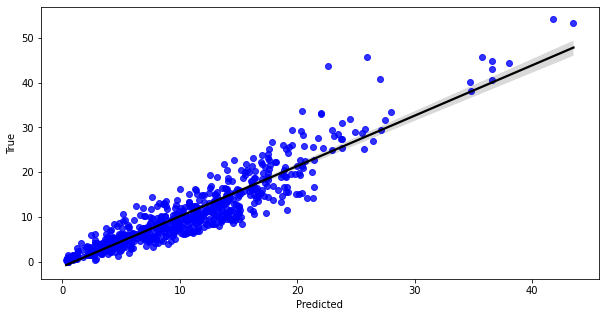

In [44]:
plt.figure(figsize=(10,5))

sns.regplot(x=reduce(lambda a,b: a+b, y_predicted_list),
            y=reduce(lambda a,b: a+b, y_true_list),
            color='blue',
            line_kws={'color':'black'})

plt.ylabel('True')
plt.xlabel('Predicted');

In [45]:
# Storing NEG predictions for figure

neg_pred = reduce(lambda a,b: a+b, y_predicted_list)

In [46]:
# Correlation Predicted X True

stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
               reduce(lambda a,b: a+b, y_predicted_list)) # returns a tuple containing (correlation, p_value)

print('Pearson correlation: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
                                                      reduce(lambda a,b: a+b, y_predicted_list))[0]))

print('p value: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
                                                      reduce(lambda a,b: a+b, y_predicted_list))[1]))

Pearson correlation: 0.9322007938857573
p value: 4.04126e-319


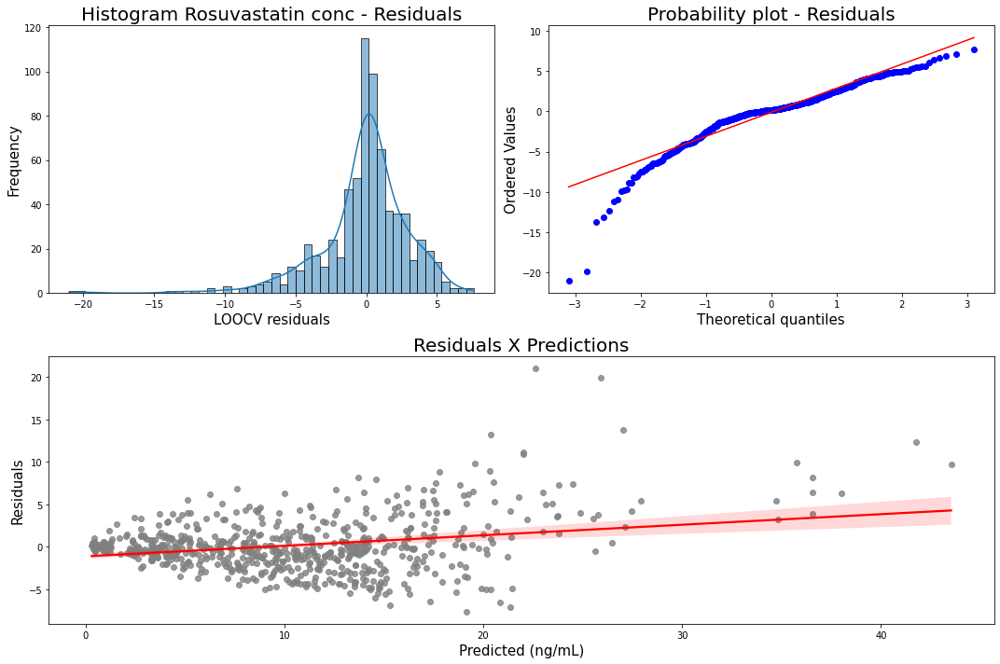

In [111]:
# defining the figure

fig = plt.figure(figsize=(15,10), facecolor='white')


# defining the axes

ax1= plt.subplot2grid((2,2), (0,0))

ax2= plt.subplot2grid((2,2), (0,1))

ax3= plt.subplot2grid((2,1), (1,0))


# Inserting data to their corresponding axes

# axes 1 - Residuals plot
sns.histplot(data=(np.array(reduce(lambda a,b: a+b, y_predicted_list))-np.array(reduce(lambda a,b: a+b, y_true_list))) , kde=True, ax=ax1)
ax1.set_title('Histogram Rosuvastatin conc - Residuals', fontdict={'color':'black', 'size':20})
ax1.set_xlabel('LOOCV residuals', fontdict={'color':'black', 'size':15})
ax1.set_ylabel('Frequency', fontdict={'color':'black', 'size':15})

#axes 2 - Probability plot
stats.probplot((np.array(reduce(lambda a,b: a+b, y_predicted_list))-np.array(reduce(lambda a,b: a+b, y_true_list))), dist='norm', rvalue=False, plot=ax2)
ax2.set_title('Probability plot - Residuals', fontdict={'color':'black', 'size':20})
ax2.set_xlabel('Theoretical quantiles', fontdict={'color':'black', 'size':15})
ax2.set_ylabel('Ordered Values', fontdict={'color':'black', 'size':15})

# axes 3 - Predicted X True
sns.regplot(x=np.array(reduce(lambda a,b: a+b, y_predicted_list)),
            y=(np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list))), 
            ci=95, 
            scatter_kws={"color": "gray"}, line_kws={"color": "red"})
ax3.set_title('Residuals X Predictions', fontdict={'color':'black', 'size':20})
ax3.set_xlabel('Predicted (ng/mL)', fontdict={'color':'black', 'size':15})
ax3.set_ylabel('Residuals', fontdict={'color':'black', 'size':15})


fig.tight_layout()

In [112]:
# Correlation Predicted X Residuals

stats.pearsonr(reduce(lambda a,b: a+b, y_true_list),
               reduce(lambda a,b: a+b, y_predicted_list)) # returns a tuple containing (correlation, p_value)

print('Pearson correlation: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_predicted_list),
                                                      np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list)).tolist())[0]))

print('p value: {}'.format(stats.pearsonr(reduce(lambda a,b: a+b, y_predicted_list),
                                                      np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list)).tolist())[1]))

Pearson correlation: 0.27372534135984916
p value: 7.703477598641778e-14


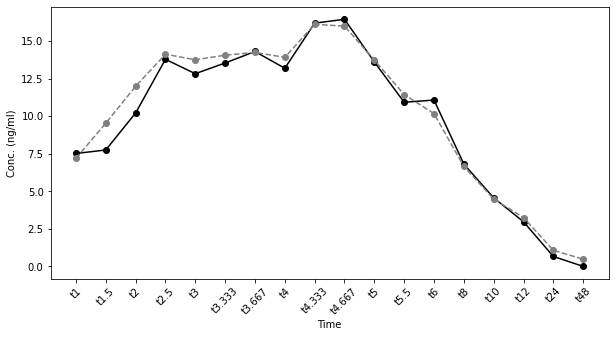

In [113]:
# Volunteer absorption profile

i=9

plt.figure(figsize=(10,5))

plt.plot(pd.DataFrame(list(y_true_list[i]), index=y_train.columns), color='black', marker='o')
plt.plot(pd.DataFrame(list(y_predicted_list[i]), index=y_train.columns), color='gray', linestyle='dashed', marker="o")
plt.ylabel('Conc. (ng/ml)')
plt.xlabel('Time')
plt.xticks(rotation=45);

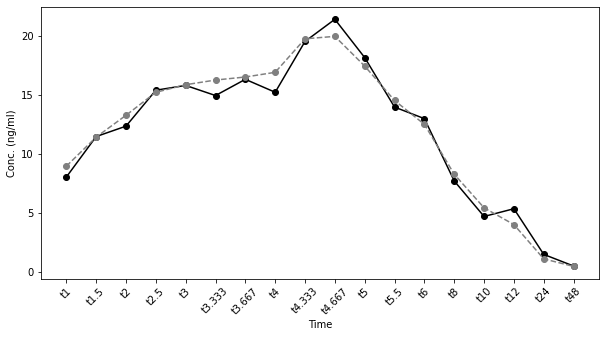

In [88]:
# Volunteer absorption profile

i=15

plt.figure(figsize=(10,5))

plt.plot(pd.DataFrame(list(y_true_list[i]), index=y_train.columns), color='black', marker='o')
plt.plot(pd.DataFrame(list(y_predicted_list[i]), index=y_train.columns), color='gray', linestyle='dashed', marker="o")
plt.ylabel('Conc. (ng/ml)')
plt.xlabel('Time')
plt.xticks(rotation=45);

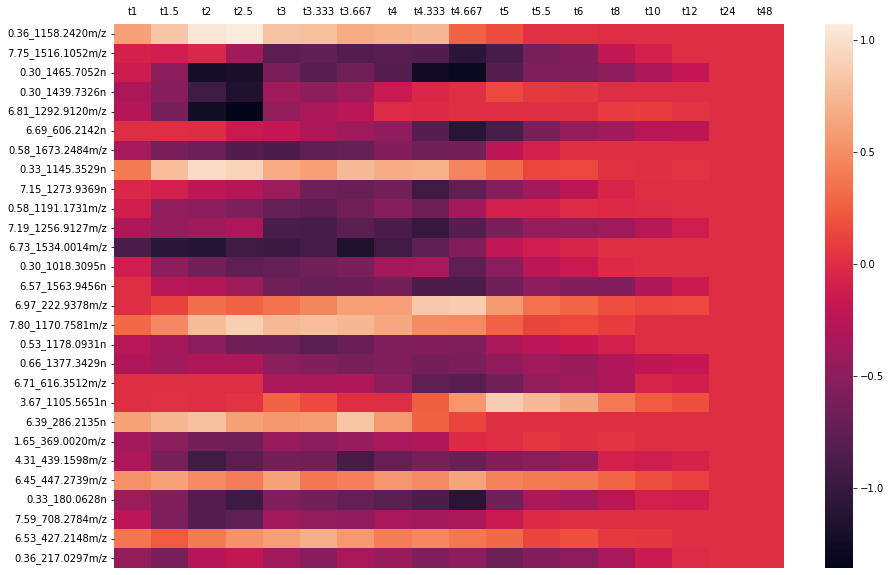

In [65]:
# Heatmap of model coefficients

# model definition 

algorithm_to_test = ElasticNet(alpha=0.9,
                               fit_intercept=True,
                               l1_ratio=0.25,
                               max_iter=100000,
                               warm_start=True,
                               selection='random',
                               random_state=42)


# model fit

algorithm_to_test.fit(selected_x_train, y_train)



# Plotting heatmap

plt.figure(figsize=(15,10))

sns.heatmap(pd.DataFrame(algorithm_to_test.coef_, columns=selected_x_train.columns, index=y_train.columns).transpose());

plt.tick_params(axis='both', which='major', labelsize=10, labelbottom = False, bottom=False, top = False, labeltop=True)



# Saving df_coef for figure

df_coef_neg = pd.DataFrame(algorithm_to_test.coef_, columns=selected_x_train.columns, index=y_train.columns)

In [66]:
df_coef_neg

,0.36_1158.2420m/z,7.75_1516.1052m/z,0.30_1465.7052n,0.30_1439.7326n,6.81_1292.9120m/z,6.69_606.2142n,0.58_1673.2484m/z,0.33_1145.3529n,7.15_1273.9369n,0.58_1191.1731m/z,...,6.71_616.3512m/z,3.67_1105.5651n,6.39_286.2135n,1.65_369.0020m/z,4.31_439.1598m/z,6.45_447.2739m/z,0.33_180.0628n,7.59_708.2784m/z,6.53_427.2148m/z,0.36_217.0297m/z
t1,0.603744,-0.079972,-0.137304,-0.338882,-0.268992,0.000000,-0.355046,0.397279,-0.036772,-0.109926,...,-0.000000,0.000000,0.606585,-0.375184,-0.322763,0.521548,-0.414829,-0.231980,0.373983,-0.464224
t1.5,0.828687,-0.119137,-0.500590,-0.530152,-0.621529,0.000000,-0.618095,0.783476,-0.091839,-0.458904,...,-0.000000,0.017311,0.730452,-0.519040,-0.623502,0.613175,-0.555154,-0.581749,0.233370,-0.614091
t2,1.035094,-0.036951,-1.230567,-0.941448,-1.237172,-0.005290,-0.686726,0.958829,-0.218742,-0.489938,...,-0.000000,0.000000,0.790300,-0.635485,-0.942616,0.477187,-0.835539,-0.828948,0.401052,-0.281606
t2.5,1.068681,-0.382320,-1.191633,-1.158160,-1.357791,-0.158656,-0.855113,0.912907,-0.276082,-0.587946,...,-0.000000,0.030581,0.603825,-0.661896,-0.773599,0.412527,-0.976405,-0.763916,0.519248,-0.200012
t3,0.811447,-0.779365,-0.616867,-0.390277,-0.461664,-0.192373,-0.868305,0.668608,-0.410120,-0.727743,...,-0.339065,0.271392,0.549251,-0.432357,-0.633207,0.612972,-0.573005,-0.386309,0.592379,-0.387219
t3.333,0.786475,-0.747898,-0.797767,-0.488079,-0.349580,-0.317850,-0.768393,0.589091,-0.671760,-0.779582,...,-0.339660,0.158558,0.579085,-0.497437,-0.648534,0.379150,-0.640428,-0.460673,0.685739,-0.536908
t3.667,0.667470,-0.844344,-0.655869,-0.391564,-0.243393,-0.393599,-0.728380,0.750997,-0.707850,-0.659949,...,-0.305560,0.007074,0.817702,-0.439645,-0.912737,0.417860,-0.727986,-0.467039,0.559056,-0.347452
t4,0.705640,-0.807451,-0.822938,-0.158275,-0.019874,-0.482151,-0.543937,0.674644,-0.646686,-0.530889,...,-0.487671,0.003343,0.562538,-0.344324,-0.720077,0.553897,-0.786999,-0.346265,0.413010,-0.435793
t4.333,0.737522,-0.849340,-1.262419,-0.037049,-0.023030,-0.818462,-0.661842,0.702916,-0.956434,-0.682662,...,-0.763119,0.250244,0.255254,-0.310356,-0.619062,0.481585,-0.883364,-0.365007,0.463344,-0.575549
t4.667,0.263728,-1.081651,-1.300826,0.000000,-0.000000,-1.093945,-0.646771,0.444476,-0.758821,-0.369154,...,-0.803465,0.539107,0.127117,-0.030408,-0.711931,0.624721,-1.095847,-0.333445,0.380991,-0.504837


# <font color="blue">Figures for scientific article</font>

In [159]:
plt.figure(figsize=(8.19,10), facecolor='white', dpi=1200)
sns.set(font_scale = 2)
#sns.set_style('white')


font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':20} #add font to the labels



ax = plt.subplot(2,1,1)


sns.regplot(x=pos_pred,
            y=reduce(lambda a,b: a+b, y_true_list),
            color='blue',
            line_kws={'color':'black'})

plt.ylabel('True ($ng.ml\u207b^1$)', fontdict = font2)


ax.text(round(((np.amax(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.03),
         round(((np.amax(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.80),
         'R2: {0}'.format(round(r2_pos,2)), fontdict = font2) # add text to the plot


ax.text(round(((np.amax(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.03),
         round(((np.amax(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.70),
         'MAPE: {0}'.format(round(mape_pos,2)), fontdict = font2) # add text to the plot


ax.text(round(((np.amax(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.03),
         round(((np.amax(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([pos_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.61),
         'RMSE: {0}'.format(round(rmse_pos,2)), fontdict = font2) # add text to the plot



ax1 = plt.subplot(2,1,2, sharex=ax)


sns.regplot(x=neg_pred,
            y=reduce(lambda a,b: a+b, y_true_list),
            color='blue',
            line_kws={'color':'black'})

plt.ylabel('True ($ng.ml\u207b^1$)', fontdict = font2)
plt.xlabel('Predicted ($ng.ml\u207b^1$)', fontdict = font2)


ax1.text(round(((np.amax(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.03),
         round(((np.amax(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.80),
         'R2: {0}'.format(round(r2_neg,2)), fontdict = font2) # add text to the plot


ax1.text(round(((np.amax(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.03),
         round(((np.amax(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.70),
         'MAPE: {0}'.format(round(mape_neg,2)), fontdict = font2) # add text to the plot


ax1.text(round(((np.amax(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.03),
         round(((np.amax(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)])))-(np.amin(np.hstack([neg_pred,reduce(lambda a,b: a+b, y_true_list)]))))*0.61),
         'RMSE: {0}'.format(round(rmse_neg,2)), fontdict = font2) # add text to the plot


ax.set_title('Rosuvastatin concentrations - ESI(+)', fontdict = font2)
ax1.set_title('Rosuvastatin concentrations - ESI(-)', fontdict = font2)


plt.tight_layout()


#plt.savefig('Figure_1.png');

In [260]:
# defining the figure

plt.figure(figsize=(8.19,10), facecolor='white', dpi=1200)
sns.set(font_scale = 1)
sns.set_style('white')



# defining the axes

ax1= plt.subplot2grid((2,2), (0,0))

ax2= plt.subplot2grid((2,2), (0,1))

ax3= plt.subplot2grid((2,1), (1,0))


# Inserting data to their corresponding axes

# axes 1 - Residuals plot
sns.histplot(data=(np.array(reduce(lambda a,b: a+b, y_predicted_list))-np.array(reduce(lambda a,b: a+b, y_true_list))) , kde=True, ax=ax1)
ax1.set_title('Histogram Rosuvastatin conc - Residuals', fontdict={'color':'black', 'size':10})
ax1.set_xlabel('LOOCV residuals', fontdict={'color':'black', 'size':10})
ax1.set_ylabel('Frequency', fontdict={'color':'black', 'size':10})

#axes 2 - Probability plot
stats.probplot((np.array(reduce(lambda a,b: a+b, y_predicted_list))-np.array(reduce(lambda a,b: a+b, y_true_list))), dist='norm', rvalue=False, plot=ax2)
ax2.set_title('Probability plot - Residuals', fontdict={'color':'black', 'size':10})
ax2.set_xlabel('Theoretical quantiles', fontdict={'color':'black', 'size':10})
ax2.set_ylabel('Ordered Values', fontdict={'color':'black', 'size':10})

# axes 3 - Predicted X True
sns.regplot(x=np.array(reduce(lambda a,b: a+b, y_predicted_list)),
            y=(np.array(reduce(lambda a,b: a+b, y_true_list)) - np.array(reduce(lambda a,b: a+b, y_predicted_list))), 
            ci=95, 
            scatter_kws={"color": "gray"}, line_kws={"color": "red"})
ax3.set_title('Residuals X Predictions', fontdict={'color':'black', 'size':10})
ax3.set_xlabel('Predicted (ng/mL)', fontdict={'color':'black', 'size':10})
ax3.set_ylabel('Residuals', fontdict={'color':'black', 'size':10})


plt.tight_layout()

#plt.savefig('Figure_2.png');

In [248]:
# Volunteer absorption profile

plt.figure(figsize=(8.19,10), facecolor='white', dpi=1200)
sns.set(font_scale = 1)
sns.set_style('white')


font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':20} #add font to the labels


i=9


ax = plt.subplot(2,2,1)

ax.plot(pd.DataFrame(list(y_true_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='black', marker='o', label='True')
ax.plot(pd.DataFrame(list(y_predicted_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='gray', linestyle='dashed', marker="o", label='Predictions')
plt.ylabel('Rosuvastatin concentration ($ng.ml\u207b^1$)')
plt.xlabel('Time (h)')
plt.legend()


ax.text(round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*2.0),
         round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*1.0),
         '(A)', fontdict = font2) # add text to the plot


i=15

ax1 = plt.subplot(2,2,2, sharey=ax)

ax1.plot(pd.DataFrame(list(y_true_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='black', marker='o')
ax1.plot(pd.DataFrame(list(y_predicted_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='gray', linestyle='dashed', marker="o")
#plt.ylabel('Rosuvastatin concentration ($ng.ml\u207b^1$)')
plt.xlabel('Time (h)')



plt.text(round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*1.7),
         round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*0.75),
         '(B)', fontdict = font2) # add text to the plot



i=10

ax2 = plt.subplot(2,2,3)

ax2.plot(pd.DataFrame(list(y_true_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='black', marker='o')
ax2.plot(pd.DataFrame(list(y_predicted_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='gray', linestyle='dashed', marker="o")
plt.ylabel('Rosuvastatin concentration ($ng.ml\u207b^1$)')
plt.xlabel('Time (h)')


plt.text(round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*1.75),
         round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*0.80),
         '(C)', fontdict = font2) # add text to the plot



i=18

ax3 = plt.subplot(2,2,4, sharey=ax2)

ax3.plot(pd.DataFrame(list(y_true_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='black', marker='o')
ax3.plot(pd.DataFrame(list(y_predicted_list[i]), index=[float(i.replace('t','')) for i in y_train.columns]), color='gray', linestyle='dashed', marker="o")
#plt.ylabel('Rosuvastatin concentration ($ng.ml\u207b^1$)')
plt.xlabel('Time (h)')


plt.text(round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*3.4),
         round(((np.amax(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])])))-(np.amin(np.hstack([list(y_true_list[i]),list(y_predicted_list[i])]))))*1.4),
         '(D)', fontdict = font2) # add text to the plot





plt.tight_layout()



#plt.savefig('Figure_3.png');